In [69]:
%matplotlib inline
import numpy as np
import pandas as pd
import glob
import os
import matplotlib.pyplot as plt
import sklearn as sk
import statsmodels.api as sm
import statsmodels.formula.api as smf
from scipy.spatial import cKDTree
from sklearn.preprocessing import MinMaxScaler
from scipy import stats
from pymer4.models import Lmer,Lm
from matplotlib import cm
from scipy.optimize import curve_fit
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)



In [70]:
pd.set_option('display.max_columns', None)

In [71]:
concatenated_df = pd.read_pickle('./concatenated_df_oct.pkl')
age = pd.read_pickle('./age_oct.pkl')


average age: 30.741868131868134
average age controls: 35.067391304347844
average age encephalitis: 28.807199999999998
average age schizophrenia: 23.2115


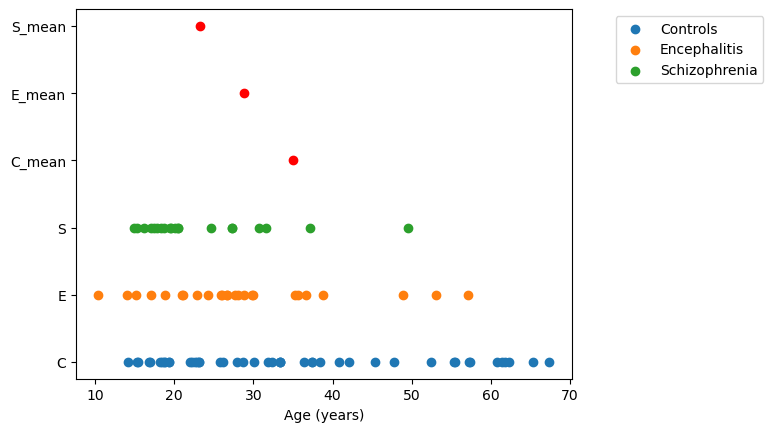

In [72]:
age['Group'] = age['Subject'].str[0]
age.tail(9)


# Session 1
print('average age:', np.mean(age.loc[age['Session']==1, 'Age']))
print('average age controls:', np.mean(age.loc[((age['Group']=='C')&(age['Session']==1)), 'Age']))
print('average age encephalitis:', np.mean(age.loc[((age['Group']=='E')&(age['Session']==1)), 'Age']))
print('average age schizophrenia:', np.mean(age.loc[((age['Group']=='S')&(age['Session']==1)), 'Age']))

# plot age
plt.scatter(age.loc[((age['Group']=='C')&(age['Session']==1)), 'Age'], age.loc[((age['Group']=='C')&(age['Session']==1)), 'Group'], label = 'Controls')
plt.scatter(age.loc[((age['Group']=='E')&(age['Session']==1)), 'Age'], age.loc[((age['Group']=='E')&(age['Session']==1)), 'Group'], label = 'Encephalitis')
plt.scatter(age.loc[((age['Group']=='S')&(age['Session']==1)), 'Age'], age.loc[((age['Group']=='S')&(age['Session']==1)), 'Group'], label = 'Schizophrenia')
plt.legend(bbox_to_anchor=(1.4, 1.0))
  
plt.errorbar(np.mean(age.loc[((age['Group']=='C')&(age['Session']==1)), 'Age']), "C_mean", xerr=stats.sem(age.loc[((age['Group']=='C')&(age['Session']==1)), 'Age']), marker="o", color = 'r')
plt.errorbar(np.mean(age.loc[((age['Group']=='E')&(age['Session']==1)), 'Age']), "E_mean", xerr=stats.sem(age.loc[((age['Group']=='C')&(age['Session']==1)), 'Age']), marker="o", color = 'r')
plt.errorbar(np.mean(age.loc[((age['Group']=='S')&(age['Session']==1)), 'Age']), "S_mean", xerr=stats.sem(age.loc[((age['Group']=='C')&(age['Session']==1)), 'Age']), marker="o", color = 'r')

plt.xlabel('Age (years)')
plt.savefig('Age variance', bbox_inches='tight')
plt.show()




In [73]:
def fill_na_mode(group):
    mode = group.mode()
    if len(mode) > 0:
        return group.fillna(mode.iloc[0])
    else:
        return group

age['sex'] = age.groupby('Subject')['M/F'].transform(fill_na_mode)


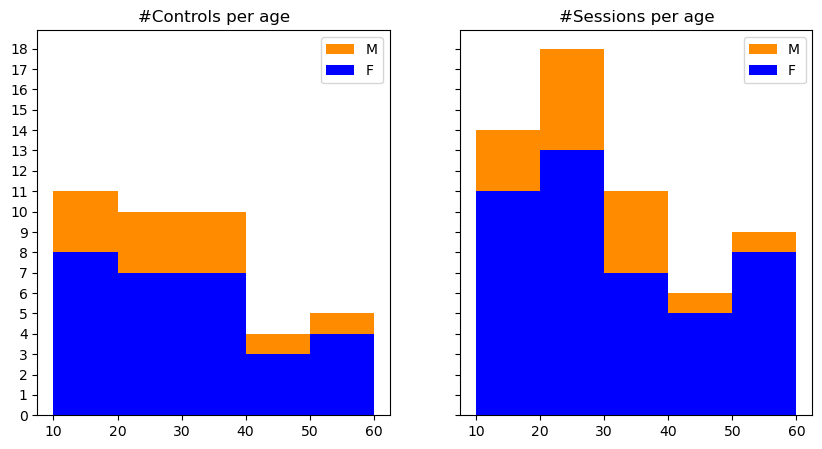

In [74]:
fig, ax = plt.subplots(1, 2, figsize = (10, 5), sharex = 'all', sharey = 'all')


ax[0].hist(age.loc[((age['Group']=='C')&(age['Session']==1)), 'Age'],color='darkorange',bins=[10, 20, 30, 40, 50, 60], label = 'M')
ax[0].hist(age.loc[((age['Group']=='C')&(age['Session']==1)&(age['sex']=='F')), 'Age'], color = 'blue',bins=[10, 20, 30, 40, 50, 60], label = 'F')
ax[0].set_yticks(np.arange(0, 20, step=1))
ax[0].legend()
ax[0].set_title('#Controls per age')

ax[1].hist(age.loc[((age['Group']=='C')), 'Age'],bins=[10, 20, 30, 40, 50, 60],color='darkorange', label = 'M')
ax[1].hist(age.loc[((age['Group']=='C')&(age['sex']=='F')), 'Age'], color = 'blue',bins=[10, 20, 30, 40, 50, 60], label = 'F')
ax[1].legend()
ax[1].set_title('#Sessions per age')

plt.show()


In [75]:
# Subsets data
crs1 = concatenated_df['Session']==1
crs2 = concatenated_df['Session']==2
crs3 = concatenated_df['Session']==3
crs4 = concatenated_df['Session']==4

cri1 = concatenated_df['Group'] == 'C'
cri2 = concatenated_df['Group'] == 'E'
cri3 = concatenated_df['Group'] == 'S'
criC = cri1 & crs1
criE = cri2 & crs1
criS = cri3 & crs1

# Only data from session 1
#data = concatenated_df[crs1]
data=concatenated_df

# Add confusional arousals
cfsubj = ['E02','E03','E05','E06','E07','E16','E21','E22','C11','C12','C14','C18']
data['ConfArousal'] = 0
data.loc[concatenated_df.Subject.isin(cfsubj),'ConfArousal'] = 1
data.loc[:,'ConfArousal'] = data.loc[:,'ConfArousal'].astype('category')


# select frontal and posterior channels
chan_fp = ['Fp1', 'Fpz', 'Fp2', 'AF7', 'AFz', 'AF8', 'F7', 'F8', 'F3','Fz', 'F4', 'F8', 'P3', 'Pz', 'P4', 'PO7', 'PO3', 
           'POz', 'PO4', 'PO8', 'O1', 'Oz', 'O2']
data_fp = concatenated_df[concatenated_df.Channel.isin(chan_fp)]

# add column indicating whether frontal or posterior electrode
#chan_f = ['Fz','F3','F4']
chan_f = ['Fz','F3','F4','F7','F8']
data_fp['Position'] = 'P'
data_fp.loc[data_fp.Channel.isin(chan_f),'Position'] = 'F'
data_fp.loc[:,'Session'] = data_fp.loc[:,'Session'].astype(int)


/tmp/ipykernel_1902968/3263902381.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_fp['Position'] = 'P'


## AGE COMPRISON between 20- and 20+

In [76]:
data_F = data_fp.copy()
data_F = data_F[data_F['Position'] == 'F'].reset_index(drop=True)
data_F.head()

,Wave,Start,NegPeak,MidCrossing,PosPeak,End,Duration,ValNegPeak,ValPosPeak,PTP,Slope,Frequency,Stage,Channel,IdxChannel,Group,Subject,Session,Age,Machine,ConfArousal,Position
0,16147,0.390689,1406.81,1407.16,1407.77,1408.12,1.64,-54.438037,56.538966,110.977003,317.077151,0.609756,2,F4,9,C,C02,1,22.91,O,0,F
1,11458,0.391044,1408.03,1408.31,1408.67,1409.26,1.50,-59.791872,41.681846,101.473718,362.406135,0.666667,2,F7,6,C,C02,1,22.91,O,0,F
2,14355,0.393181,1415.75,1416.35,1416.68,1416.93,1.48,-43.574775,38.377907,81.952683,136.587804,0.675676,2,Fz,8,C,C02,1,22.91,O,0,F
3,11459,0.393536,1417.03,1417.28,1417.47,1417.69,0.96,-82.223783,45.544797,127.768579,511.074318,1.041667,2,F7,6,C,C02,1,22.91,O,0,F
4,14356,0.397639,1431.74,1431.96,1432.18,1432.82,1.32,-42.860329,34.949432,77.809761,353.680731,0.757576,2,Fz,8,C,C02,1,22.91,O,0,F


In [77]:
data_F['Id'] = data_F['Subject'] + '_' + data_F['Session'].astype(str)
data_F['time_n'] = data_F['Start']
time_threshold = 0.005
slope_threshold = 0.20

def filter_group(group):
    tree = cKDTree(group[['time_n', 'Slope']])
    pairs = tree.query_pairs(r=np.sqrt(time_threshold**2 + slope_threshold**2))
    keep = np.ones(len(group), dtype=bool)
    for i, j in pairs:
        keep[j] = False
    return group[keep]

data_F = data_F.groupby('Id', group_keys=False).apply(filter_group).drop(columns=['time_n']).reset_index(drop=True)


In [78]:

def find_next_bigger(sorted_array, value1):
    for num in sorted_array:
        if num > value1:
            return num
    
    return None

def first_block_all(data, data_n3, bin_size, threshold_sum,id):
    if len(data_n3) < threshold_sum:
         return None

    hist_values, bin_edges = np.histogram(data, bins=np.arange(0, round(max(data),2) + bin_size, bin_size))
    hist_valuesn3, bin_edgesn3 = np.histogram(data_n3, bins=np.arange(0, round(max(data_n3),2) + bin_size, bin_size))

    nz_indices = np.where(hist_values > 10)[0]
    nz_indices3 = np.where(hist_valuesn3 > 5)[0]

    nz_edges = np.round(bin_edges[nz_indices],2)
    nz_edges3 = np.round(bin_edgesn3[nz_indices3],2)

    cbins = [nz_edges3[0]]
    if id == 'C07_1':
        print(nz_edges)

    if nz_edges[0] > cbins[0]:
        nz_edges = np.concatenate(([cbins[0]], nz_edges))

    for i in range(1, len(nz_edges)): 
        if nz_edges[i] in nz_edges3 or nz_edges[i] > cbins[0]:
            if round(nz_edges[i] - nz_edges[i - 1],2) == bin_size:
                if id == 'C07_1':
                 print(nz_edges[i])
                cbins.append(nz_edges[i])
            else:
                if (sum(hist_values[np.searchsorted(bin_edges, cbins[0]):np.searchsorted(bin_edges, cbins[-1])]) > threshold_sum):
                    if id == 'C07_1':
                        print(cbins)
                        print(sum(hist_values[np.searchsorted(bin_edges, cbins[0]):np.searchsorted(bin_edges, cbins[-1])]))
                    return cbins[0]

                if nz_edges[i] in nz_edges3:
                    cbins = [nz_edges[i]]
                else:
                    if find_next_bigger(nz_edges3, nz_edges[i]) is not None:
                        cbins = [find_next_bigger(nz_edges3, nz_edges[i])]
                    else:
                        return None

    if sum(hist_values[np.searchsorted(bin_edges, cbins[0]):np.searchsorted(bin_edges, cbins[-1])]) > threshold_sum:
                if id == 'C07_1':
                        print(cbins)
                        print(sum(hist_values[np.searchsorted(bin_edges, cbins[0]):np.searchsorted(bin_edges, cbins[-1])]))
                return cbins[0]
    return None



data_starts = data_F.groupby('Id').apply(
    lambda x: first_block_all(
        data=x['Start'],
        data_n3=x[x['Stage'] == 3]['Start'],
        bin_size=0.05,
        threshold_sum=350, #250?
        id = x['Id'].values[0]
    )
).reset_index(name='Start_Block')




[0.85 0.9  0.95 1.   1.05 1.1  1.2  1.25 1.45 2.25 2.3  2.4  2.45 2.5
 2.55 2.65 3.55 3.95 4.75 4.8  4.85 6.25 6.3  6.35 6.4  6.45 6.5  6.55
 6.6 ]
0.9
0.95
1.0
1.05
1.1
2.3
2.45
2.5
2.55
4.8
4.85
6.3
6.35
6.4
6.45
6.5
6.55
6.6


In [79]:
data_starts[data_starts['Id']=='C07_1']

,Id,Start_Block
7,C07_1,NaN


In [80]:
data_F

,Wave,Start,NegPeak,MidCrossing,PosPeak,End,Duration,ValNegPeak,ValPosPeak,PTP,Slope,Frequency,Stage,Channel,IdxChannel,Group,Subject,Session,Age,Machine,ConfArousal,Position,Id
0,16147,0.390689,1406.81,1407.16,1407.77,1408.12,1.64,-54.438037,56.538966,110.977003,317.077151,0.609756,2,F4,9,C,C02,1,22.91,O,0,F,C02_1
1,11458,0.391044,1408.03,1408.31,1408.67,1409.26,1.50,-59.791872,41.681846,101.473718,362.406135,0.666667,2,F7,6,C,C02,1,22.91,O,0,F,C02_1
2,14355,0.393181,1415.75,1416.35,1416.68,1416.93,1.48,-43.574775,38.377907,81.952683,136.587804,0.675676,2,Fz,8,C,C02,1,22.91,O,0,F,C02_1
3,11459,0.393536,1417.03,1417.28,1417.47,1417.69,0.96,-82.223783,45.544797,127.768579,511.074318,1.041667,2,F7,6,C,C02,1,22.91,O,0,F,C02_1
4,14356,0.397639,1431.74,1431.96,1432.18,1432.82,1.32,-42.860329,34.949432,77.809761,353.680731,0.757576,2,Fz,8,C,C02,1,22.91,O,0,F,C02_1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
642064,18543,7.966611,28680.11,28680.40,28680.63,28681.26,1.46,-116.404911,63.626076,180.030987,620.796507,0.684932,2,F7,6,S,S22,1,18.30,N,0,F,S22_1
642065,29095,7.966636,28680.17,28680.46,28680.70,28681.07,1.18,-50.067150,27.750825,77.817975,268.337845,0.847458,2,F8,10,S,S22,1,18.30,N,0,F,S22_1
642066,27450,7.971547,28698.09,28698.40,28698.71,28699.28,1.71,-94.930981,79.295763,174.226745,562.021757,0.584795,2,F4,9,S,S22,1,18.30,N,0,F,S22_1
642067,24612,7.982069,28736.41,28736.68,28736.87,28737.16,1.71,-75.461099,42.263394,117.724493,436.016639,0.584795,2,Fz,8,S,S22,1,18.30,N,0,F,S22_1


data_F = data_F[data_F.Id != 'E17_1']
data_F = data_F[data_F.Id != 'E14_1']
data_F = data_F[data_F.Id != 'E14_2']
data_F = data_F[data_F.Id != 'E24_1']
data_F = data_F[data_F.Id != 'E07_1']
data_F = data_F[data_F.Id != 'E07_2']
data_F = data_F[data_F.Id != 'E07_3']
data_F = data_F[data_F.Id != 'E20_1']




In [81]:
data_F['N23_times'] = data_F['Id'].map(data_starts.set_index('Id')['Start_Block'])
data_F = data_F.dropna(subset=['N23_times'])
data_F['time_rel'] = data_F['Start'] - data_F['N23_times']
data_F = data_F[data_F['time_rel'] >= 0]

data_F['N3_times'] = data_F['Start'].where(data_F['Stage'] == 3)
N3_start_time = data_F.groupby(['Subject','Session'])['N3_times'].transform('min')

data_F['N3_times'] = N3_start_time

#############################################################################

data_F.loc[data_F['Id'] == 'C03_4', 'N3_times'] += 0.05
data_F.loc[data_F['Id'] == 'C04_1', 'N3_times'] += 0.1
data_F.loc[data_F['Id'] == 'C06_1', 'N3_times'] += 0.02
data_F.loc[data_F['Id'] == 'C14_1', 'N3_times'] += 0.23

##############################################################################


data_F['time_rel'] = data_F['Start'] - data_F['N3_times']
data_F['diff'] = data_F['N3_times'] - data_F['N23_times']

data_allF = data_F[(data_F['time_rel'] <= 0.5) & (data_F['time_rel'] >= 0)]
#data_allF = data_allF[(data_allF['Stage'] == 3) | (data_allF['time_rel'] >= 0.2)]

data_allF = data_allF.dropna(subset=['Age'])

/tmp/ipykernel_1902968/1461330469.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_F['time_rel'] = data_F['Start'] - data_F['N23_times']


In [82]:
#####################################################################################################

data_allF = data_allF[~((data_allF['time_rel'] > 0.4) & (data_allF['Id'] == 'C02_1'))]
data_allF = data_allF[~((data_allF['time_rel'] > 0.3) & (data_allF['Id'] == 'C03_1'))]
data_allF = data_allF[~((data_allF['time_rel'] > 0.4) & (data_allF['Id'] == 'C05_4'))]
data_allF = data_allF[~((data_allF['time_rel'] > 0.3) & (data_allF['Id'] == 'C07_1'))]
data_allF = data_allF[~((data_allF['time_rel'] > 0.3) & (data_allF['Id'] == 'C09_1'))]
data_allF = data_allF[~((data_allF['time_rel'] > 0.45) & (data_allF['Id'] == 'C13_4'))]
data_allF = data_allF[~((data_allF['time_rel'] > 0.38) & (data_allF['Id'] == 'C15_4'))]
data_allF = data_allF[~((data_allF['time_rel'] > 0.42) & (data_allF['Id'] == 'C14_4'))]
data_allF = data_allF[~((data_allF['time_rel'] > 0.4) & (data_allF['Id'] == 'C38_1'))]
data_allF = data_allF[~((data_allF['time_rel'] > 0.3) & (data_allF['Id'] == 'C16_1'))]

##################################################################################################

data_allF = data_allF[~((data_allF['time_rel'] > 0.4) & (data_allF['Id'] == 'E07_1'))]
data_allF = data_allF[~((data_allF['time_rel'] > 0.35) & (data_allF['Id'] == 'E07_2'))]
data_allF = data_allF[~((data_allF['time_rel'] > 0.4) & (data_allF['Id'] == 'E07_3'))]
data_allF = data_allF[~((data_allF['time_rel'] > 0.4) & (data_allF['Id'] == 'E08_3'))]
data_allF = data_allF[~((data_allF['time_rel'] > 0.4) & (data_allF['Id'] == 'E10_3'))]
data_allF = data_allF[~((data_allF['time_rel'] > 0.25) & (data_allF['Id'] == 'E15_4'))]
data_allF = data_allF[~((data_allF['time_rel'] > 0.3) & (data_allF['Id'] == 'E17_1'))]
data_allF = data_allF[~((data_allF['time_rel'] > 0.4) & (data_allF['Id'] == 'E17_3'))]
data_allF = data_allF[~((data_allF['time_rel'] > 0.35) & (data_allF['Id'] == 'E20_2'))]
data_allF = data_allF[~((data_allF['time_rel'] > 0.35) & (data_allF['Id'] == 'E25_1'))]

##############################################################################################

data_allF = data_allF[~((data_allF['time_rel'] > 0.4) & (data_allF['Id'] == 'S15_4'))]
data_allF = data_allF[~((data_allF['time_rel'] > 0.3) & (data_allF['Id'] == 'S16_1'))]
data_allF = data_allF[~((data_allF['time_rel'] > 0.3) & (data_allF['Id'] == 'S13_1'))]

data_F['Id'] = data_F['Subject'] + '_' + data_F['Session'].astype(str)

data_F['condBlock'] = 0
for index, row in data_F.iterrows():
    if row['Stage'] == 3:
        t0 = row['Start']
        t0_5 = t0 + 0.5
        id = row['Id']
        data_Id = data_F.where(data_F['Id'] == id)
        data_Id['N3'] = data_Id['Stage'].apply(lambda x: 1 if x == 3 else 0)
        c = data_Id[(data_Id['Start'] > t0) & (data_Id['Start'] <= t0_5)] 
        c = c['N3'].eq(1).sum()
        if c >= 100:
            row['condBlock'] = 1

In [83]:
result_df = data_allF.groupby('Id')['diff'].first().reset_index()
result_df[0:60]



,Id,diff
0,C02_1,0.011431
1,C03_1,0.024964
2,C03_4,0.086644
3,C04_1,0.104475
4,C05_4,0.005172
5,C06_1,0.023678
6,C06_4,0.008653
7,C07_4,0.043039
8,C08_1,0.036106
9,C08_4,0.017881


In [84]:
data_18_3 = data_allF[data_allF['Stage']==3]
data_18_3[data_18_3['Id']=='E18_4']['Start']

473394    2.004731
473395    2.004733
473396    2.004733
473401    2.021253
473402    2.022114
            ...   
473812    2.496189
473813    2.496919
473814    2.496922
473815    2.496928
473816    2.496931
Name: Start, Length: 416, dtype: float64

In [85]:
result_df = data_allF.groupby('Id')['N3_times'].first().reset_index()
result_df[75:125]


,Id,N3_times
75,E10_3,1.083822
76,E10_4,1.038361
77,E11_1,0.279928
78,E11_2,1.520881
79,E11_3,0.869794
80,E11_4,0.585106
81,E13_1,0.825111
82,E13_2,0.317656
83,E13_3,0.451278
84,E13_4,0.476772


In [86]:
data_allF[data_allF['Id'] == 'C02_1'].head(9)

,Wave,Start,NegPeak,MidCrossing,PosPeak,End,Duration,ValNegPeak,ValPosPeak,PTP,Slope,Frequency,Stage,Channel,IdxChannel,Group,Subject,Session,Age,Machine,ConfArousal,Position,Id,N23_times,time_rel,N3_times,diff
53,14366,0.711431,2561.41,2561.65,2561.89,2562.17,1.02,-43.055807,39.801527,82.857334,345.238892,0.980392,3,Fz,8,C,C02,1,22.91,O,0,F,C02_1,0.7,0.000000,0.711431,0.011431
54,16157,0.711439,2561.44,2561.67,2561.92,2562.21,1.03,-41.747439,44.001763,85.749202,372.822617,0.970874,3,F4,9,C,C02,1,22.91,O,0,F,C02_1,0.7,0.000008,0.711431,0.011431
55,11472,0.718289,2586.16,2586.47,2586.69,2587.44,1.60,-67.717177,20.232169,87.949346,283.707569,0.625000,3,F7,6,C,C02,1,22.91,O,0,F,C02_1,0.7,0.006858,0.711431,0.011431
56,12771,0.718289,2586.20,2586.51,2586.74,2587.45,1.61,-103.667240,46.635767,150.303006,484.848408,0.621118,3,F3,7,C,C02,1,22.91,O,0,F,C02_1,0.7,0.006858,0.711431,0.011431
57,16158,0.718289,2586.21,2586.55,2586.80,2587.41,1.57,-91.779559,43.404657,135.184215,397.600633,0.636943,3,F4,9,C,C02,1,22.91,O,0,F,C02_1,0.7,0.006858,0.711431,0.011431
58,17692,0.718289,2586.19,2586.53,2586.87,2587.36,1.52,-49.231720,26.332969,75.564689,222.249086,0.657895,3,F8,10,C,C02,1,22.91,O,0,F,C02_1,0.7,0.006858,0.711431,0.011431
59,16159,0.722950,2602.98,2603.20,2603.48,2603.80,1.18,-62.086992,91.715645,153.802637,699.102896,0.847458,3,F4,9,C,C02,1,22.91,O,0,F,C02_1,0.7,0.011519,0.711431,0.011431
60,14367,0.728472,2622.79,2623.03,2623.25,2623.97,1.47,-45.009583,36.084354,81.093936,337.891401,0.680272,3,Fz,8,C,C02,1,22.91,O,0,F,C02_1,0.7,0.017042,0.711431,0.011431
61,16160,0.730631,2630.59,2630.83,2631.04,2631.30,1.03,-90.122824,65.240226,155.363050,647.346042,0.970874,3,F4,9,C,C02,1,22.91,O,0,F,C02_1,0.7,0.019200,0.711431,0.011431


In [87]:

#SEPARATE BINNED DATA_F in 20- and 20+

bins_data_F = data_allF.copy()
bins_data_F = bins_data_F[bins_data_F['Session']==1]
bins_data_F['time_rel'] = pd.cut(bins_data_F['time_rel'], bins=8)  # Adjust the number of bins as needed


print (len(bins_data_F))

#older group
bdf_o = bins_data_F[bins_data_F['Age'] > 18]
print(len(bdf_o))

bdf_o = bdf_o.groupby(['Session','Subject','time_rel'])['Slope'].mean().reset_index()
bdf_o['Group'] = bdf_o['Subject'].str[0]
mdf_o = bdf_o.groupby(['Group','time_rel'])['Slope'].agg(['mean', 'sem']).reset_index()

#younger group
bdf_y = bins_data_F[bins_data_F['Age'] <= 18]
print(len(bdf_y))

bdf_y = bdf_y.groupby(['Session','Subject','time_rel'])['Slope'].mean().reset_index()
bdf_y['Group'] = bdf_y['Subject'].str[0]
mdf_y = bdf_y.groupby(['Group','time_rel'])['Slope'].agg(['mean', 'sem']).reset_index()

#all
bins_data_F = bins_data_F.groupby(['Session','Subject','time_rel'])['Slope'].mean().reset_index()
bins_data_F['Group'] = bins_data_F['Subject'].str[0]
mean_data_F = bins_data_F.groupby(['Group','time_rel'])['Slope'].agg(['mean', 'sem']).reset_index()


67606
48533
19073


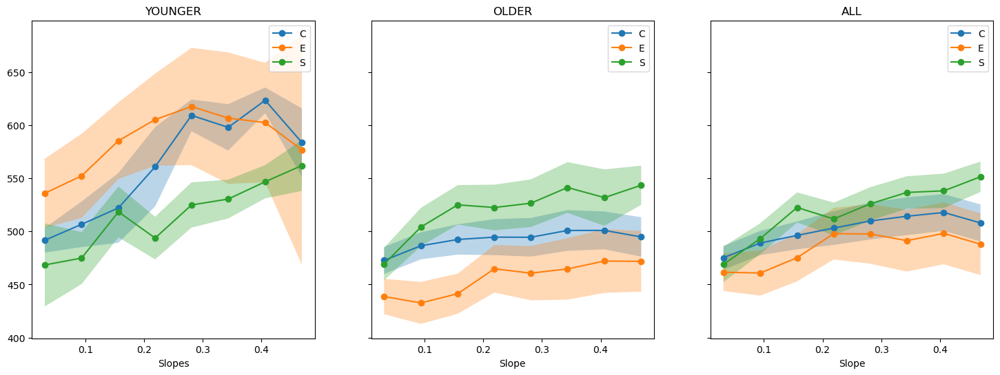

In [88]:
fig, ax = plt.subplots(1, 3, figsize = (18, 6), sharex = 'all', sharey = 'all')

# Plot the individual curves for each name
mdf_o["time_rel_c"] = mdf_o["time_rel"].apply(lambda x: x.mid)
mdf_y["time_rel_c"] = mdf_y["time_rel"].apply(lambda x: x.mid)
mean_data_F["time_rel_c"] = mean_data_F["time_rel"].apply(lambda x: x.mid)
time_intervals = mdf_o['time_rel_c'].unique()

#YOUNGER
ax[0].set_title('YOUNGER')
for name, group in mdf_y.groupby('Group'):
    ax[0].plot(time_intervals, group['mean'], marker='o', label=name)
    ax[0].fill_between(time_intervals, group['mean'] - group['sem'],
                     group['mean'] + group['sem'], alpha=0.3)

ax[0].set_xlabel('Time')
ax[0].set_xlabel('Slopes')
ax[0].legend()

#OLDER
ax[1].set_title('OLDER')
for name, group in mdf_o.groupby('Group'):
    ax[1].plot(time_intervals, group['mean'], marker='o', label=name)
    ax[1].fill_between(time_intervals, group['mean'] - group['sem'],
                     group['mean'] + group['sem'], alpha=0.3)

ax[1].set_xlabel('Time')
ax[1].set_xlabel('Slope')
ax[1].legend()

#ALL
ax[2].set_title('ALL')
for name, group in mean_data_F.groupby('Group'):
    ax[2].plot(time_intervals, group['mean'], marker='o', label=name)
    ax[2].fill_between(time_intervals, group['mean'] - group['sem'],
                     group['mean'] + group['sem'], alpha=0.3)

ax[2].set_xlabel('Time')
ax[2].set_xlabel('Slope')
ax[2].legend()



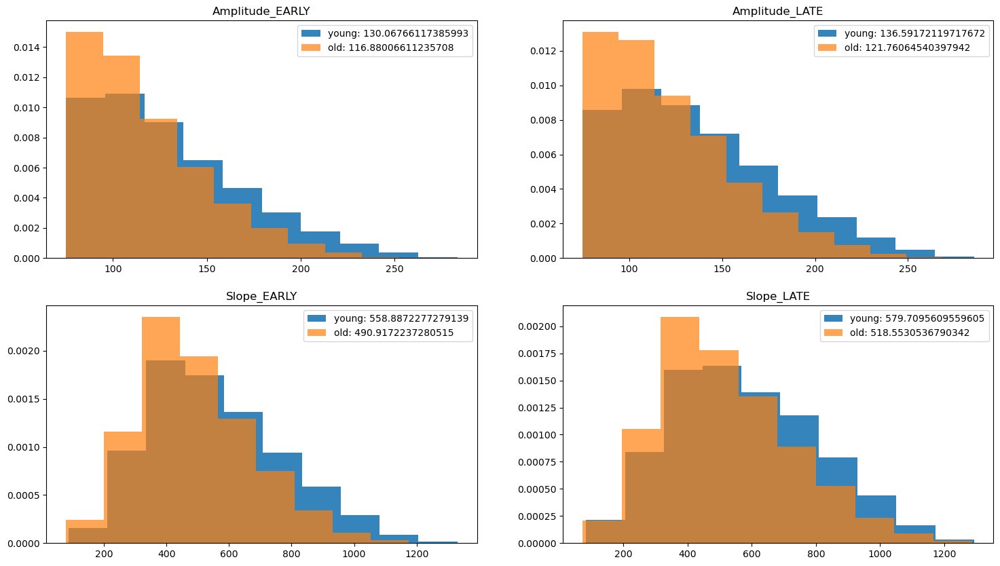

In [89]:
fig, ax = plt.subplots(2, 2, figsize = (18, 10))

data_young = data_allF[data_allF['Age'] < 20]
data_old = data_allF[data_allF['Age'] >= 20]


data_early_young = data_young[data_young['time_rel'] <= 0.3]
data_late_young = data_young[data_young['time_rel'] >= 0.4]
data_early_old = data_old[data_old['time_rel'] <= 0.3]
data_late_old = data_old[data_old['time_rel'] >= 0.4]

ax[0,0].hist(data_early_young.PTP, density = True, alpha = 0.9, label = 'young: ' + str(np.mean(data_early_young.PTP)) )
ax[0,0].hist(data_early_old.PTP, density = True, alpha = 0.7, label = 'old: ' + str(np.mean(data_early_old.PTP)))
ax[0,0].set_title('Amplitude_EARLY')
ax[0,0].legend()

ax[0,1].hist(data_late_young.PTP, density = True, alpha = 0.9, label = 'young: ' + str(np.mean(data_late_young.PTP)) )
ax[0,1].hist(data_late_old.PTP, density = True, alpha = 0.7, label = 'old: ' + str(np.mean(data_late_old.PTP)))
ax[0,1].set_title('Amplitude_LATE')
ax[0,1].legend()

ax[1,0].hist(data_early_young.Slope, density = True, alpha = 0.9, label = 'young: ' + str(np.mean(data_early_young.Slope)) )
ax[1,0].hist(data_early_old.Slope, density = True, alpha = 0.7, label = 'old: ' + str(np.mean(data_early_old.Slope)))
ax[1,0].set_title('Slope_EARLY')
ax[1,0].legend()

ax[1,1].hist(data_late_young.Slope, density = True, alpha = 0.9, label = 'young: ' + str(np.mean(data_late_young.Slope)) )
ax[1,1].hist(data_late_old.Slope, density = True, alpha = 0.7, label = 'old: ' + str(np.mean(data_late_old.Slope)))
ax[1,1].set_title('Slope_LATE')
ax[1,1].legend()


     Wave     Start  NegPeak  MidCrossing  PosPeak      End  Duration  \
53  14366  0.711431  2561.41      2561.65  2561.89  2562.17      1.02   
54  16157  0.711439  2561.44      2561.67  2561.92  2562.21      1.03   
55  11472  0.718289  2586.16      2586.47  2586.69  2587.44      1.60   
56  12771  0.718289  2586.20      2586.51  2586.74  2587.45      1.61   
57  16158  0.718289  2586.21      2586.55  2586.80  2587.41      1.57   

    ValNegPeak  ValPosPeak         PTP       Slope  Frequency  Stage Channel  \
53  -43.055807   39.801527   82.857334  345.238892   0.980392      3      Fz   
54  -41.747439   44.001763   85.749202  372.822617   0.970874      3      F4   
55  -67.717177   20.232169   87.949346  283.707569   0.625000      3      F7   
56 -103.667240   46.635767  150.303006  484.848408   0.621118      3      F3   
57  -91.779559   43.404657  135.184215  397.600633   0.636943      3      F4   

    IdxChannel Group Subject Session    Age Machine ConfArousal Position  \
53  

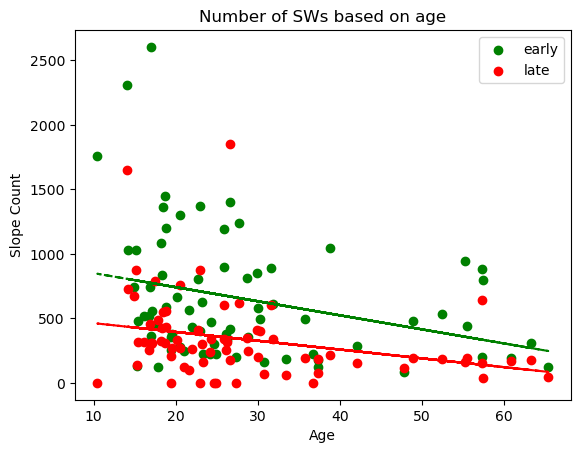

In [90]:

x_early_list = []
y_early_list = []
x_late_list = []
y_late_list = []

for name, Subject in data_allF.groupby('Subject'):
    data_early = Subject[Subject['time_rel'] <= 0.2]
    data_late = Subject[Subject['time_rel'] >= 0.4]

    print(data_early[0:5])

    x_early_list.append(Subject['Age'].unique()[0])
    y_early_list.append(data_early['Slope'].count())

    x_late_list.append(Subject['Age'].unique()[0])
    y_late_list.append(data_late['Slope'].count())

plt.scatter(x_early_list, y_early_list, marker='o', c='green', label='early')
plt.scatter(x_late_list, y_late_list, marker='o', c='red', label='late')

print(len(x_early_list))

early_fit = np.polyfit(x_early_list, y_early_list, 1)
late_fit = np.polyfit(x_late_list, y_late_list, 1)

plt.plot(x_early_list, np.polyval(early_fit, x_early_list), color='green', linestyle='--')
plt.plot(x_late_list, np.polyval(late_fit, x_late_list), color='red', linestyle='--')

plt.title('Number of SWs based on age')
plt.xlabel('Age')
plt.ylabel('Slope Count')
plt.legend()
plt.show()



# Age modelling for controls

In [91]:
bdf_c = data_allF.copy()
bdf_c = bdf_c[bdf_c['Group']=='C']
bdf_c.head()

,Wave,Start,NegPeak,MidCrossing,PosPeak,End,Duration,ValNegPeak,ValPosPeak,PTP,Slope,Frequency,Stage,Channel,IdxChannel,Group,Subject,Session,Age,Machine,ConfArousal,Position,Id,N23_times,time_rel,N3_times,diff
53,14366,0.711431,2561.41,2561.65,2561.89,2562.17,1.02,-43.055807,39.801527,82.857334,345.238892,0.980392,3,Fz,8,C,C02,1,22.91,O,0,F,C02_1,0.7,0.000000,0.711431,0.011431
54,16157,0.711439,2561.44,2561.67,2561.92,2562.21,1.03,-41.747439,44.001763,85.749202,372.822617,0.970874,3,F4,9,C,C02,1,22.91,O,0,F,C02_1,0.7,0.000008,0.711431,0.011431
55,11472,0.718289,2586.16,2586.47,2586.69,2587.44,1.60,-67.717177,20.232169,87.949346,283.707569,0.625000,3,F7,6,C,C02,1,22.91,O,0,F,C02_1,0.7,0.006858,0.711431,0.011431
56,12771,0.718289,2586.20,2586.51,2586.74,2587.45,1.61,-103.667240,46.635767,150.303006,484.848408,0.621118,3,F3,7,C,C02,1,22.91,O,0,F,C02_1,0.7,0.006858,0.711431,0.011431
57,16158,0.718289,2586.21,2586.55,2586.80,2587.41,1.57,-91.779559,43.404657,135.184215,397.600633,0.636943,3,F4,9,C,C02,1,22.91,O,0,F,C02_1,0.7,0.006858,0.711431,0.011431


In [92]:
# Obtain first hour of SWS:

#BINS DATA FRAME _ CONTROLS

bdf_c = data_allF.copy()
bdf_c = bdf_c[bdf_c['Group']=='C']
bdf_c['time_rel'] = pd.cut(bdf_c['time_rel'], bins=6)  # Adjust the number of bins as needed
print(len(bdf_c['Id'].unique()))

bdf_c = bdf_c.groupby(['Session','Subject','time_rel'])['Slope'].mean().reset_index()
bdf_c['Group'] = bdf_c['Subject'].str[0]

age_c = age[age['Group']=='C']
#age_c = age_c[age_c['Session']==1]

bdf_c = bdf_c.merge(age_c)
bdf_c.head()


48


,Session,Subject,time_rel,Slope,Group,Birthdate,Testdate,M/F,Age,sex
0,1,C02,"(-0.0005, 0.0833]",451.427524,C,1994-05-28 00:00:00,2017-04-26 00:00:00,F,22.91,F
1,1,C02,"(0.0833, 0.167]",461.897149,C,1994-05-28 00:00:00,2017-04-26 00:00:00,F,22.91,F
2,1,C02,"(0.167, 0.25]",494.219918,C,1994-05-28 00:00:00,2017-04-26 00:00:00,F,22.91,F
3,1,C02,"(0.25, 0.333]",575.735571,C,1994-05-28 00:00:00,2017-04-26 00:00:00,F,22.91,F
4,1,C02,"(0.333, 0.417]",550.220247,C,1994-05-28 00:00:00,2017-04-26 00:00:00,F,22.91,F


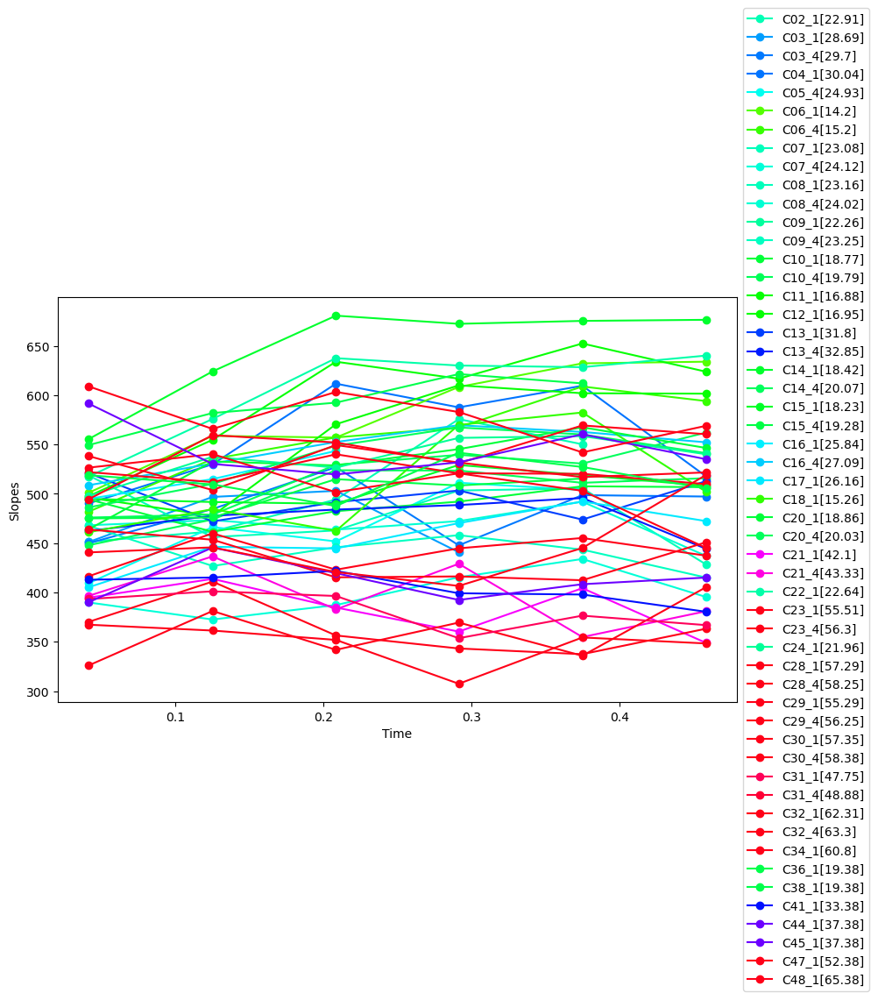

In [93]:

plt.figure(figsize=(10, 6))

# Plot the individual curves for each age

bdf_c["time_rel_c"] = bdf_c["time_rel"].apply(lambda x: x.mid).astype('object')
time_intervals = bdf_c['time_rel_c'].unique()
bdf_c['Id'] = bdf_c['Subject'] + '_' + bdf_c['Session'].astype(str)
for name, Id in bdf_c.groupby('Id'):
    plt.plot(time_intervals, Id['Slope'], marker='o', c = cm.hsv(Id['Age'].unique()[0]/50), label=str(name) + str(Id['Age'].unique()))

plt.xlabel('Time')
plt.ylabel('Slopes')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()



[0.0414 0.12515 0.20850000000000002 0.2915 0.375 0.4585]


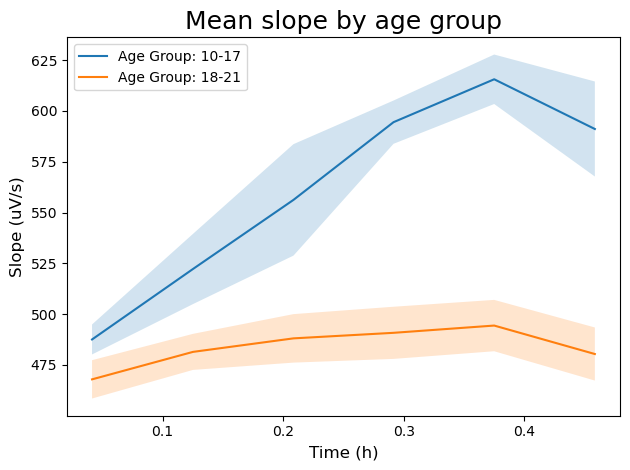

In [94]:
bins = [10, 18, np.inf]
labels = ['10-17','18-21']
bdf_c['age_group'] = pd.cut(bdf_c['Age'], bins=bins, labels=labels, right=False)

print(time_intervals)

for age_group, group_data in bdf_c.groupby('age_group'):
    mean_score = group_data.groupby('time_rel_c')['Slope'].mean()
    sem_score = group_data.groupby('time_rel_c')['Slope'].sem()
    plt.plot(time_intervals, mean_score.values, label=f'Age Group: {age_group}')
    plt.fill_between(mean_score.index, mean_score - sem_score, mean_score + sem_score, alpha=0.2)


plt.xlabel('Time (h)',fontsize=12)
plt.ylabel('Slope (uV/s)',fontsize=12)
plt.title('Mean slope by age group', fontsize=18)
plt.legend()
plt.tight_layout()
plt.savefig('Age_dist')
plt.show()

32


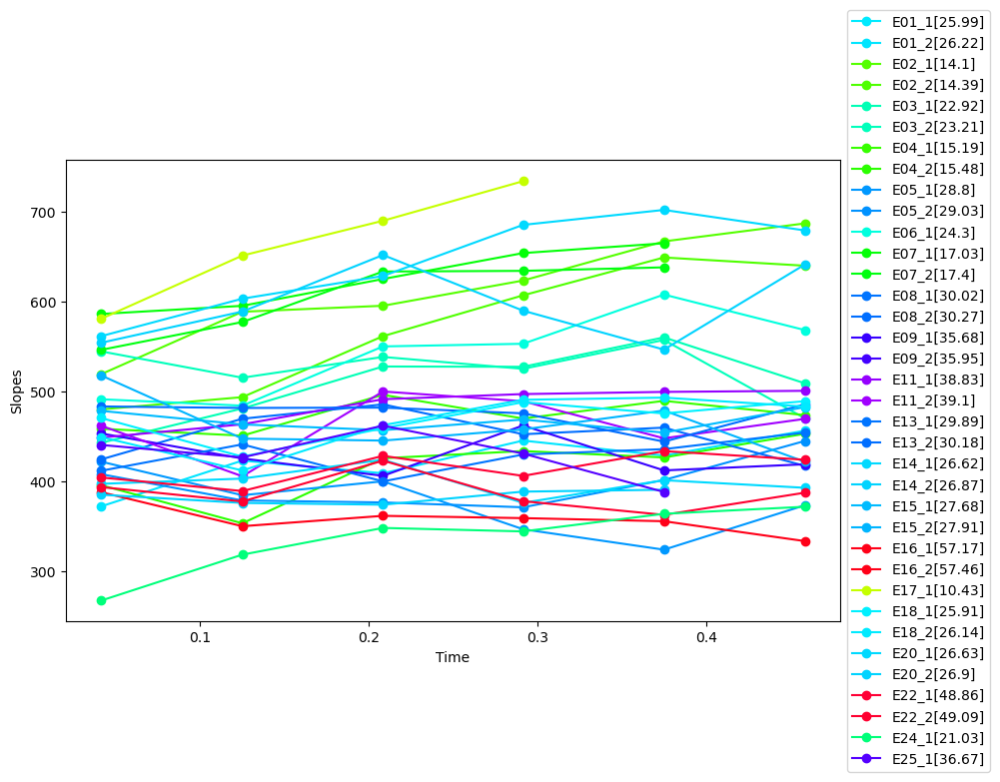

In [95]:
# Obtain first hour of SWS:

#BINS DATA FRAME _ E

bdf_e = data_allF.copy()
bdf_e = bdf_e[bdf_e['Group']=='E']
bdf_e = bdf_e[bdf_e['Session']!=3]
bdf_e = bdf_e[bdf_e['Session']!=4]
bdf_e['time_rel'] = pd.cut(bdf_e['time_rel'], bins=6)  # Adjust the number of bins as needed
print(len(bdf_e['Id'].unique()))

bdf_e = bdf_e.groupby(['Session','Subject','time_rel'])['Slope'].mean().reset_index()
bdf_e['Group'] = bdf_e['Subject'].str[0]

age_e = age[age['Group']=='E']
#age_c = age_c[age_c['Session']==1]

bdf_e = bdf_e.merge(age_e)

plt.figure(figsize=(10, 6))

# Plot the individual curves for each age

bdf_e["time_rel_c"] = bdf_e["time_rel"].apply(lambda x: x.mid).astype('object')
time_intervals = bdf_e['time_rel_c'].unique()
bdf_e['Id'] = bdf_e['Subject'] + '_' + bdf_e['Session'].astype(str)
for name, Id in bdf_e.groupby('Id'):
    plt.plot(time_intervals, Id['Slope'], marker='o', c = cm.hsv(Id['Age'].unique()[0]/50), label=str(name) + str(Id['Age'].unique()))

plt.xlabel('Time')
plt.ylabel('Slopes')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()


[0.0414 0.12515 0.20850000000000002 0.2915 0.375 0.4585]


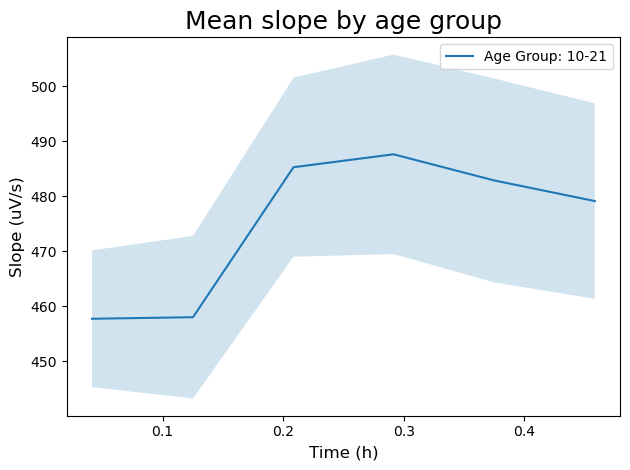

In [96]:
bins = [10, np.inf]
labels = ['10-21']
bdf_e['age_group'] = pd.cut(bdf_e['Age'], bins=bins, labels=labels, right=False)

print(time_intervals)

for age_group, group_data in bdf_e.groupby('age_group'):
    mean_score = group_data.groupby('time_rel_c')['Slope'].mean()
    sem_score = group_data.groupby('time_rel_c')['Slope'].sem()
    plt.plot(time_intervals, mean_score.values, label=f'Age Group: {age_group}')
    plt.fill_between(mean_score.index, mean_score - sem_score, mean_score + sem_score, alpha=0.2)


plt.xlabel('Time (h)',fontsize=12)
plt.ylabel('Slope (uV/s)',fontsize=12)
plt.title('Mean slope by age group', fontsize=18)
plt.legend()
plt.tight_layout()
plt.savefig('Age_dist')
plt.show()

23


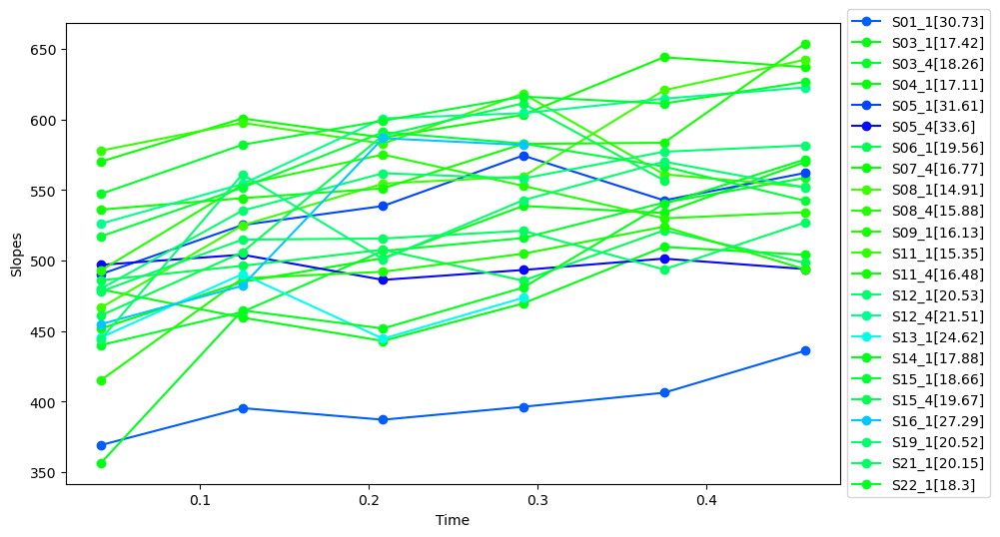

In [97]:
# Obtain first hour of SWS:

#BINS DATA FRAME _ S

bdf_s = data_allF.copy()
bdf_s = bdf_s[bdf_s['Group']=='S']
#bdf_s = bdf_s[bdf_s['Session']==1]
bdf_s['time_rel'] = pd.cut(bdf_s['time_rel'], bins=6)  # Adjust the number of bins as needed
print(len(bdf_s['Id'].unique()))

bdf_s = bdf_s.groupby(['Session','Subject','time_rel'])['Slope'].mean().reset_index()
bdf_s['Group'] = bdf_s['Subject'].str[0]

age_s = age[age['Group']=='S']
#age_c = age_c[age_c['Session']==1]

bdf_s = bdf_s.merge(age_s)

plt.figure(figsize=(10, 6))

# Plot the individual curves for each age

bdf_s["time_rel_c"] = bdf_s["time_rel"].apply(lambda x: x.mid).astype('object')
time_intervals = bdf_s['time_rel_c'].unique()
bdf_s['Id'] = bdf_s['Subject'] + '_' + bdf_s['Session'].astype(str)
for name, Id in bdf_s.groupby('Id'):
    plt.plot(time_intervals, Id['Slope'], marker='o', c = cm.hsv(Id['Age'].unique()[0]/50), label=str(name) + str(Id['Age'].unique()))

plt.xlabel('Time')
plt.ylabel('Slopes')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()


[0.0414 0.12515 0.20850000000000002 0.2915 0.375 0.4585]


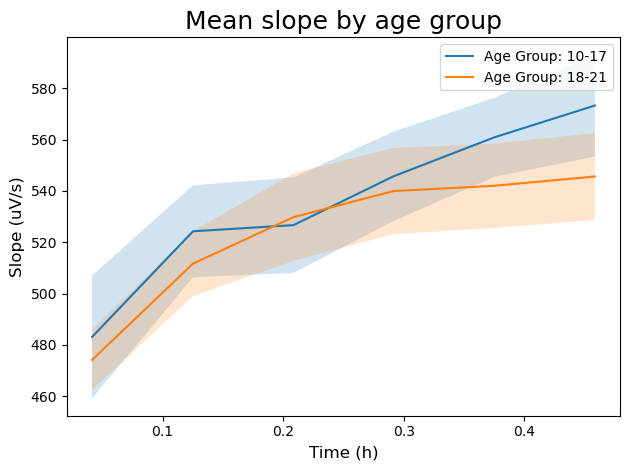

In [98]:
bins = [10, 18, np.inf]
labels = ['10-17','18-21']
bdf_s['age_group'] = pd.cut(bdf_s['Age'], bins=bins, labels=labels, right=False)

print(time_intervals)

for age_group, group_data in bdf_s.groupby('age_group'):
    mean_score = group_data.groupby('time_rel_c')['Slope'].mean()
    sem_score = group_data.groupby('time_rel_c')['Slope'].sem()
    plt.plot(time_intervals, mean_score.values, label=f'Age Group: {age_group}')
    plt.fill_between(mean_score.index, mean_score - sem_score, mean_score + sem_score, alpha=0.2)


plt.xlabel('Time (h)',fontsize=12)
plt.ylabel('Slope (uV/s)',fontsize=12)
plt.title('Mean slope by age group', fontsize=18)
plt.legend()
plt.tight_layout()
plt.savefig('Age_dist')
plt.show()

In [99]:
daf_c = data_allF.copy()
daf_c = daf_c[data_allF['Group']=='C']
#daf_c = daf_c[daf_c['Subject'].isin(daf_c['Subject'].value_counts()[daf_c['Subject'].value_counts() >= 20].index)]
daf_c['sAge'] = daf_c['Age']/50
print(len(daf_c['Id'].unique()))

48


[]

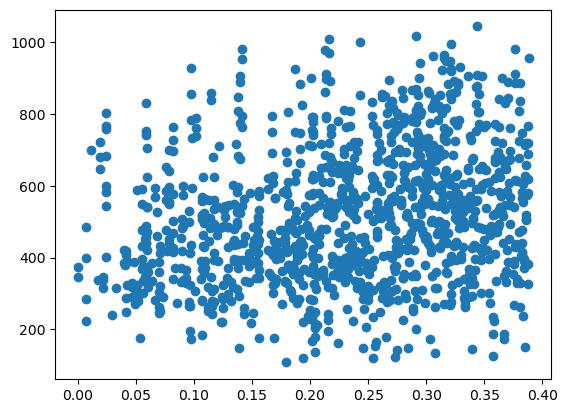

In [100]:
daf_c = data_allF.copy()
daf_c = daf_c[data_allF['Group']=='C']
daf_c = daf_c[daf_c['Id'] == 'C02_1']
plt.scatter(daf_c.time_rel,daf_c.Slope)
plt.plot()


[0.00000000e+00 8.33333333e-06 6.85833333e-03 6.85833333e-03
 6.85833333e-03 6.85833333e-03 1.15194444e-02 1.70416667e-02
 1.92000000e-02 1.92111111e-02 1.92111111e-02 2.21055556e-02
 2.21111111e-02 2.21250000e-02 2.41361111e-02 2.41416667e-02
 2.41444444e-02 2.41500000e-02 2.46805556e-02 2.46888889e-02
 2.46944444e-02 2.46944444e-02 2.90694444e-02 3.31611111e-02
 3.98888889e-02 3.98944444e-02 4.04583333e-02 4.12944444e-02
 4.12944444e-02 4.12972222e-02 4.13000000e-02 4.20500000e-02
 4.20583333e-02 4.20583333e-02 4.70777778e-02 4.70944444e-02
 4.71027778e-02 4.86194444e-02 4.90194444e-02 4.90277778e-02
 5.06277778e-02 5.06333333e-02 5.06722222e-02 5.11083333e-02
 5.16944444e-02 5.21500000e-02 5.36333333e-02 5.50555556e-02
 5.50583333e-02 5.50611111e-02 5.54194444e-02 5.54222222e-02
 5.54222222e-02 5.61111111e-02 5.61138889e-02 5.61222222e-02
 5.79888889e-02 5.79888889e-02 5.83972222e-02 5.83972222e-02
 5.84055556e-02 5.84083333e-02 5.84166667e-02 5.87694444e-02
 5.87722222e-02 5.936666

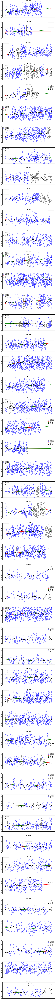

In [101]:

#LOG NO BINS
daf_c = data_allF.copy()
daf_c = daf_c[data_allF['Group']=='C']
#daf_c = daf_c[daf_c['Subject'].isin(daf_c['Subject'].value_counts()[daf_c['Subject'].value_counts() >= 20].index)]
daf_c['sAge'] = daf_c['Age']/50

def func(x, a, b, c):
    return a - (b * np.exp(-x/c))

def func_l(x, m,n):
    return m + n*x


x_list = []
a_list = []
b_list = []
c_list = []

m_list = []
n_list = []

# Get the number of subplots needed
num_subplots = len(daf_c['Id'].unique())

# Create a figure and subplots
fig, axs = plt.subplots(num_subplots, 1, figsize=(15, 6*num_subplots),sharex=True, gridspec_kw={'hspace': 0.3})

for idx, (name, Subject) in enumerate(daf_c.groupby('Id')):

    x = Subject.time_rel.values
    x = x[:int(len(x)*0.60)]
    y = Subject.Slope.values
    y = y[:int(len(y)*0.60)] 

    if name == 'C02_1':
        print(x)
        print(y)

    popt, pcov = curve_fit(func, x, y, bounds=([0, -1000, 0], [1000, 1000, 5]))

    coef_a = popt[0]
    coef_b = popt[1]
    coef_c = popt[2]

    x_list.append(Subject['Age'].unique()[0])
    a_list.append(coef_a)
    b_list.append(coef_b)
    c_list.append(coef_c)

    poptl, pcovl = curve_fit(func_l, x, y, bounds=([0, -1000], [1000, 1000]))

    coef_m = popt[0]
    coef_n = popt[1]


    m_list.append(coef_m)
    n_list.append(coef_n)



    # Plot on the respective subplot
    x_time = np.arange(0,0.5,0.01)
    Subject_2 = Subject[Subject['Stage']==2]
    Subject_3 = Subject[Subject['Stage']==3]
    axs[idx].scatter(Subject_2.time_rel.values, Subject_2.Slope.values,c='gray',label='N2 SW Values')
    axs[idx].scatter(Subject_3.time_rel.values, Subject_3.Slope.values,c='blue',label='N3 SW Values', alpha=0.5)
    axs[idx].plot(x_time, func(x_time, popt[0], popt[1], popt[2]), color='red', label='log pred')
    axs[idx].plot(x_time, func_l(x_time, poptl[0], poptl[1]), color='green', label='lineal pred')
    axs[idx].set_title(name + ' ' + str(Subject['Age'].unique()[0]))
    bins_Subject = Subject.copy()
    bins_Subject['time_rel'] = pd.cut(bins_Subject['time_rel'], bins=30)
    bins_Subject = bins_Subject.groupby(['Session','Subject','time_rel'])['Slope'].mean().reset_index()
    bins_Subject["time_rel_c"] = bins_Subject["time_rel"].apply(lambda x: x.mid)
    time_intervals = bins_Subject['time_rel_c'].unique()
    axs[idx].plot(time_intervals, bins_Subject['Slope'], marker='o', c = 'black', label='Mean bins')
    axs[idx].set_ylim([100,1000])
    axs[idx].legend()


plt.show()
        



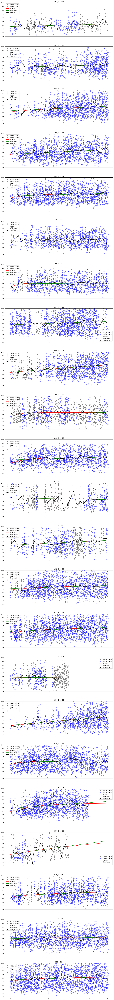

In [102]:
#LOG NO BINS
daf_s = data_allF.copy()
daf_s = daf_s[data_allF['Group']=='S']
#daf_c = daf_c[daf_c['Subject'].isin(daf_c['Subject'].value_counts()[daf_c['Subject'].value_counts() >= 20].index)]
daf_s['sAge'] = daf_s['Age']/50

def func(x, a, b, c):
    return a - (b * np.exp(-x/c))

def func_l(x, m,n):
    return m + n*x


x_list = []
a_list = []
b_list = []
c_list = []

m_list = []
n_list = []

# Get the number of subplots needed
num_subplots = len(daf_s['Id'].unique())

# Create a figure and subplots
fig, axs = plt.subplots(num_subplots, 1, figsize=(15, 6*num_subplots),sharex=True, gridspec_kw={'hspace': 0.3})

for idx, (name, Subject) in enumerate(daf_s.groupby('Id')):

    x = Subject.time_rel.values
    y = Subject.Slope.values

    if name == 'C02_1':
        print(x)
        print(y)

    popt, pcov = curve_fit(func, x, y, bounds=([0, -1000, 0], [1000, 1000, 5]))

    coef_a = popt[0]
    coef_b = popt[1]
    coef_c = popt[2]

    x_list.append(Subject['Age'].unique()[0])
    a_list.append(coef_a)
    b_list.append(coef_b)
    c_list.append(coef_c)

    poptl, pcovl = curve_fit(func_l, x, y, bounds=([0, -1000], [1000, 1000]))

    coef_m = popt[0]
    coef_n = popt[1]


    m_list.append(coef_m)
    n_list.append(coef_n)



    # Plot on the respective subplot
    x_time = np.arange(0,0.5,0.01)
    Subject_2 = Subject[Subject['Stage']==2]
    Subject_3 = Subject[Subject['Stage']==3]
    axs[idx].scatter(Subject_2.time_rel.values, Subject_2.Slope.values,c='gray',label='N2 SW Values')
    axs[idx].scatter(Subject_3.time_rel.values, Subject_3.Slope.values,c='blue',label='N3 SW Values', alpha=0.5)
    axs[idx].plot(x_time, func(x_time, popt[0], popt[1], popt[2]), color='red', label='log pred')
    axs[idx].plot(x_time, func_l(x_time, poptl[0], poptl[1]), color='green', label='lineal pred')
    axs[idx].set_title(name + ' ' + str(Subject['Age'].unique()[0]))
    bins_Subject = Subject.copy()
    bins_Subject['time_rel'] = pd.cut(bins_Subject['time_rel'], bins=30)
    bins_Subject = bins_Subject.groupby(['Session','Subject','time_rel'])['Slope'].mean().reset_index()
    bins_Subject["time_rel_c"] = bins_Subject["time_rel"].apply(lambda x: x.mid)
    time_intervals = bins_Subject['time_rel_c'].unique()
    axs[idx].plot(time_intervals, bins_Subject['Slope'], marker='o', c = 'black', label='Mean bins')
    axs[idx].set_ylim([100,1000])
    axs[idx].legend()


plt.show()

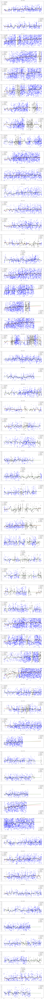

In [103]:
#LOG NO BINS
daf_e = data_allF.copy()
daf_e = daf_e[data_allF['Group']=='E']
#daf_c = daf_c[daf_c['Subject'].isin(daf_c['Subject'].value_counts()[daf_c['Subject'].value_counts() >= 20].index)]
daf_e['sAge'] = daf_e['Age']/50

def func(x, a, b, c):
    return a - (b * np.exp(-x/c))

def func_l(x, m,n):
    return m + n*x


x_list = []
a_list = []
b_list = []
c_list = []

m_list = []
n_list = []

# Get the number of subplots needed
num_subplots = len(daf_e['Id'].unique())

# Create a figure and subplots
fig, axs = plt.subplots(num_subplots, 1, figsize=(15, 6*num_subplots),sharex=True, gridspec_kw={'hspace': 0.3})

for idx, (name, Subject) in enumerate(daf_e.groupby('Id')):

    x = Subject.time_rel.values
    y = Subject.Slope.values

    if name == 'C02_1':
        print(x)
        print(y)

    popt, pcov = curve_fit(func, x, y, bounds=([0, -1000, 0], [1000, 1000, 5]))

    coef_a = popt[0]
    coef_b = popt[1]
    coef_c = popt[2]

    x_list.append(Subject['Age'].unique()[0])
    a_list.append(coef_a)
    b_list.append(coef_b)
    c_list.append(coef_c)

    poptl, pcovl = curve_fit(func_l, x, y, bounds=([0, -1000], [1000, 1000]))

    coef_m = popt[0]
    coef_n = popt[1]


    m_list.append(coef_m)
    n_list.append(coef_n)



    # Plot on the respective subplot
    x_time = np.arange(0,0.5,0.01)
    Subject_2 = Subject[Subject['Stage']==2]
    Subject_3 = Subject[Subject['Stage']==3]
    axs[idx].scatter(Subject_2.time_rel.values, Subject_2.Slope.values,c='gray',label='N2 SW Values')
    axs[idx].scatter(Subject_3.time_rel.values, Subject_3.Slope.values,c='blue',label='N3 SW Values', alpha=0.5)
    axs[idx].plot(x_time, func(x_time, popt[0], popt[1], popt[2]), color='red', label='log pred')
    axs[idx].plot(x_time, func_l(x_time, poptl[0], poptl[1]), color='green', label='lineal pred')
    axs[idx].set_title(name + ' ' + str(Subject['Age'].unique()[0]))
    bins_Subject = Subject.copy()
    bins_Subject['time_rel'] = pd.cut(bins_Subject['time_rel'], bins=30)
    bins_Subject = bins_Subject.groupby(['Session','Subject','time_rel'])['Slope'].mean().reset_index()
    bins_Subject["time_rel_c"] = bins_Subject["time_rel"].apply(lambda x: x.mid)
    time_intervals = bins_Subject['time_rel_c'].unique()
    axs[idx].plot(time_intervals, bins_Subject['Slope'], marker='o', c = 'black', label='Mean bins')
    axs[idx].set_ylim([100,1000])
    axs[idx].legend()


plt.show()

In [104]:
Subject.head()

,Wave,Start,NegPeak,MidCrossing,PosPeak,End,Duration,ValNegPeak,ValPosPeak,PTP,Slope,Frequency,Stage,Channel,IdxChannel,Group,Subject,Session,Age,Machine,ConfArousal,Position,Id,N23_times,time_rel,N3_times,diff,sAge
491152,8007,0.728111,2621.42,2621.62,2621.86,2622.11,0.91,-52.923192,59.342276,112.265468,561.327338,1.098901,3,Fz,8,E,E25,1,36.67,N,0,F,E25_1,0.7,0.000000,0.728111,0.028111,0.7334
491153,9419,0.728119,2621.45,2621.67,2621.88,2622.10,0.87,-58.973675,53.997274,112.970949,513.504315,1.149425,3,F4,9,E,E25,1,36.67,N,0,F,E25_1,0.7,0.000008,0.728111,0.028111,0.7334
491154,8008,0.734992,2646.24,2646.45,2646.63,2646.79,0.82,-56.349654,43.057772,99.407426,473.368696,1.219512,3,Fz,8,E,E25,1,36.67,N,0,F,E25_1,0.7,0.006881,0.728111,0.028111,0.7334
491155,6880,0.735000,2646.26,2646.47,2646.64,2646.80,0.80,-51.586939,35.159664,86.746603,413.079063,1.250000,3,F3,7,E,E25,1,36.67,N,0,F,E25_1,0.7,0.006889,0.728111,0.028111,0.7334
491156,8010,0.738606,2659.20,2659.41,2659.58,2659.75,0.77,-56.441888,36.445988,92.887876,442.323220,1.298701,3,Fz,8,E,E25,1,36.67,N,0,F,E25_1,0.7,0.010494,0.728111,0.028111,0.7334


[0.0414 0.12515 0.20850000000000002 0.2915 0.375 0.4585]
 _____________ Fitted Parameters So:
M: 503.4621781049739
N: -0.9207397250477327
 _____________ Fitted Parameters St:
a: -37.90989389453365
b: -898.7251431515225
c: 13.769244223839543
[[ 2.10300827e+03 -1.34750617e+04 -2.46232462e+02]
 [-1.34750617e+04  2.25570843e+05  2.98743682e+03]
 [-2.46232462e+02  2.98743682e+03  4.39105234e+01]]


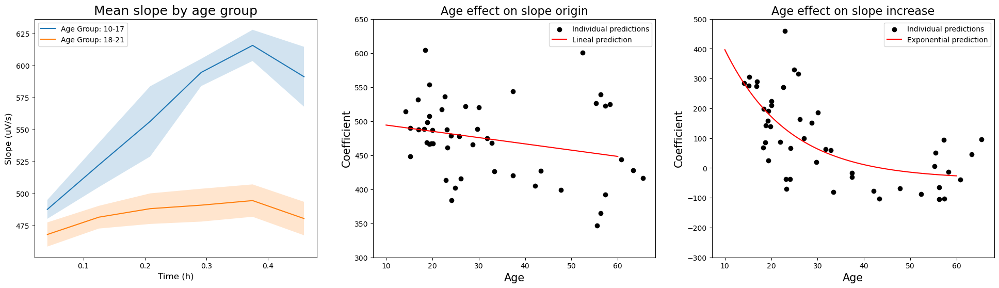

In [105]:

fig, ax = plt.subplots(1, 3, figsize = (24, 6))


bins = [10, 18, np.inf]
labels = ['10-17','18-21']
bdf_c['age_group'] = pd.cut(bdf_c['Age'], bins=bins, labels=labels, right=False)
time_intervals = bdf_c['time_rel_c'].unique()
print(time_intervals)

for age_group, group_data in bdf_c.groupby('age_group'):
    mean_score = group_data.groupby('time_rel_c')['Slope'].mean()
    sem_score = group_data.groupby('time_rel_c')['Slope'].sem()
    ax[0].plot(time_intervals, mean_score.values, label=f'Age Group: {age_group}')
    ax[0].fill_between(mean_score.index, mean_score - sem_score, mean_score + sem_score, alpha=0.2)


ax[0].set_xlabel('Time (h)',fontsize=12)
ax[0].set_ylabel('Slope (uV/s)',fontsize=12)
ax[0].set_title('Mean slope by age group', fontsize=18)
ax[0].legend()



#LOG NO BINS


daf_c = data_allF[data_allF['Group']=='C']


#CONTROL SWA found

daf_c = daf_c[daf_c['Subject'].isin(daf_c['Subject'].value_counts()[daf_c['Subject'].value_counts() >= 20].index)]


daf_c['sAge'] = daf_c['Age']/50


def func_l(x, m, n):
    return m + n*x

def func_exp(x, a, b, c):
    return a  - (b * np.exp(-x/c))


x_list = []
m_list = []
n_list = []


for name, Subject in daf_c.groupby('Id'):
    #plt.scatter(Subject.time_rel.values,Subject.Slope.values)
    x = Subject.time_rel.values
    #x = x[0:int(len(x)*0.85)]
    y = Subject.Slope.values
    #y = y[0:int(len(y)*0.85)]
    popt, pcov = curve_fit(func_l, x, y,bounds=([0,-1000],[1000,1000]))

    #plt.plot(x, func(x,popt[0],popt[1],popt[2]))
    coef_m = popt[0]
    coef_n = popt[1]

    x_list.append(Subject['Age'].unique()[0])
    m_list.append(coef_m)
    n_list.append(coef_n)



splot = 0
coef_names = ['So','St']
total_coefs = []

for coef_list in [m_list,n_list]:
    y_list = coef_list

    sorted_data = sorted(zip(x_list, y_list))
    x_sorted, y_sorted = zip(*sorted_data)
    x_sorted = np.array(x_sorted)
    y_sorted = np.array(y_sorted)

    if splot == 0:
        
        popt_t, pcov_t = curve_fit(func_l, x_sorted, y_sorted,bounds=([0,-1000],[1000,1000]))

        print(" _____________ Fitted Parameters " + coef_names[splot]+":")
        print("M:", popt_t[0])
        print("N:", popt_t[1])

        total_coefs.append(popt_t[0])
        total_coefs.append(popt_t[1])


        x_ages = np.linspace(10,60,200)

        ax[splot+1].scatter(x_sorted, y_sorted, marker='o', c='black', label='Individual predictions')
        ax[splot+1].plot(x_ages, func_l(x_ages, popt_t[0], popt_t[1]), c='red', label='Lineal prediction')
        ax[splot+1].set_title('Age effect on slope origin',fontsize=16)

    else: 
        popt_t, pcov_t,info, mesg,ier= curve_fit(func_exp, x_sorted, y_sorted, bounds=([-10000, -15000, 0], [10000, 0, 1000]), full_output=True)
        df_s_slopes = pd.DataFrame({
            'Age': x_sorted,
            's_slope': y_sorted
        })

        print(" _____________ Fitted Parameters " + coef_names[splot]+":")
        print("a:", popt_t[0])
        print("b:", popt_t[1])
        print("c:", popt_t[2])
        print(pcov_t)

        total_coefs.append(popt_t[0])
        total_coefs.append(popt_t[1])
        total_coefs.append(popt_t[2])
    

        x_ages = np.linspace(10,60,200)

        ax[splot+1].scatter(x_sorted, y_sorted, marker='o', c='black', label='Individual predictions')
        ax[splot+1].plot(x_ages, func_exp(x_ages, popt_t[0], popt_t[1], popt_t[2]), c='red', label='Exponential prediction')
        ax[splot+1].set_title('Age effect on slope increase',fontsize=16)

    
    ax[splot+1].set_xlabel('Age',fontsize=15)
    ax[splot+1].set_ylabel('Coefficient',fontsize=15)


    if splot == 0:
        ax[splot+1].set_ylim([300,650])
    else:
        ax[splot+1].set_ylim([-300,500])

    ax[splot+1].legend()


    splot = splot + 1


plt.savefig('Age model.svg', bbox_inches='tight')
plt.show()



In [106]:
df_serial_bias = pd.read_csv('Serial_bias')
print(df_serial_bias[0:5])
print(df_s_slopes[0:5])

  subject  session      bias group    Id    Age
0     C06        1  0.869146     C  C061  14.20
1     C06        4  1.267683     C  C064  15.20
2     C15        1 -0.011884     C  C151  18.23
3     C14        1 -0.664623     C  C141  18.42
4     C10        1  0.651750     C  C101  18.77
     Age     s_slope
0  14.20  285.585385
1  15.20  276.296330
2  15.26  305.551958
3  16.88  275.007749
4  16.95  290.771643


In [107]:
df_serial_age = pd.merge(df_serial_bias, df_s_slopes, on='Age', how='inner')

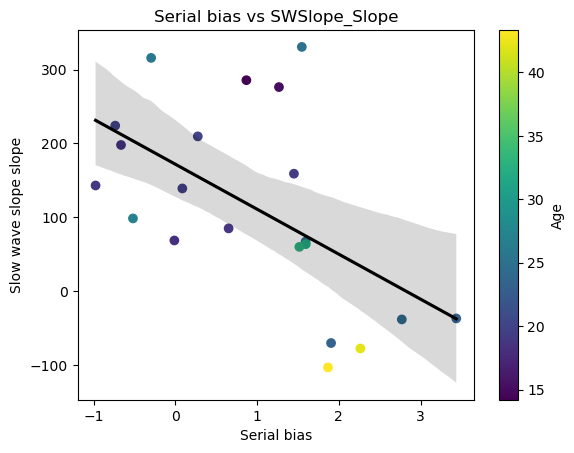

In [108]:
import seaborn as sns

plt.scatter(df_serial_age['bias'], df_serial_age['s_slope'], c=df_serial_age['Age'], cmap='viridis')
plt.colorbar(label='Age')
sns.regplot(x='bias', y='s_slope', data=df_serial_age, scatter=False, color='black')

plt.xlabel('Serial bias')
plt.ylabel('Slow wave slope slope')
plt.title('Serial bias vs SWSlope_Slope')

plt.show()

In [109]:
df_serial_age

,subject,session,bias,group,Id,Age,s_slope
0,C06,1,0.869146,C,C061,14.20,285.585385
1,C06,4,1.267683,C,C064,15.20,276.296330
2,C15,1,-0.011884,C,C151,18.23,68.830195
3,C14,1,-0.664623,C,C141,18.42,197.991729
4,C10,1,0.651750,C,C101,18.77,85.145250
5,C20,1,-0.975957,C,C201,18.86,143.190949
6,C15,4,1.451061,C,C154,19.28,159.112960
7,C10,4,0.085725,C,C104,19.79,139.178708
8,C20,4,-0.735631,C,C204,20.03,224.124482
9,C14,4,0.274762,C,C144,20.07,209.611988


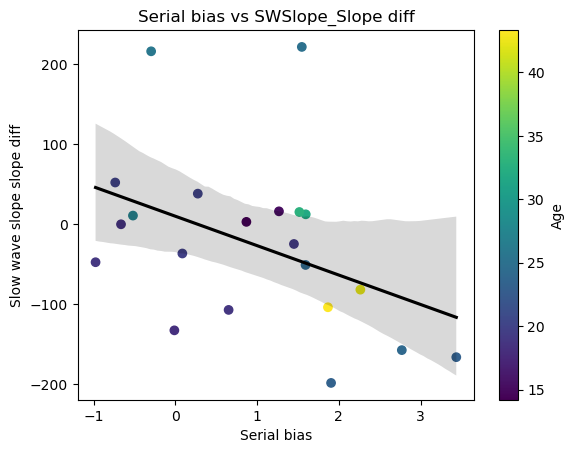

In [110]:
df_serial_age['slope_diff'] = (
    df_serial_age['s_slope'] - (total_coefs[2] - total_coefs[3] * np.exp(-df_serial_age['Age'] / total_coefs[4])) 
)
import seaborn as sns

plt.scatter(df_serial_age['bias'], df_serial_age['slope_diff'], c=df_serial_age['Age'], cmap='viridis')
plt.colorbar(label='Age')
sns.regplot(x='bias', y='slope_diff', data=df_serial_age, scatter=False, color='black')

plt.xlabel('Serial bias')
plt.ylabel('Slow wave slope slope diff')
plt.title('Serial bias vs SWSlope_Slope diff')
plt.show()

In [111]:
df_serial_bias_ext = pd.read_csv('Serial_biases_at_3seconds.csv')
df_serial_bias_ext = df_serial_bias_ext.rename(columns={'subject': 'Subject'})
df_serial_bias_ext.head()


,Unnamed: 0,group,Subject,session,SB,SB_diff,SB_par,SB_diff_par
0,0,C,C03,4,0.461568,0.500720,1.244044,1.568705
1,1,C,C05,1,1.573502,1.675930,3.569075,4.039286
2,2,C,C06,1,1.550943,1.515878,3.080607,3.078142
3,3,C,C07,1,2.674182,2.000715,6.811011,5.862129
4,4,C,C08,1,2.043802,1.889595,5.272403,4.884354


<Axes: xlabel='Age', ylabel='SB'>

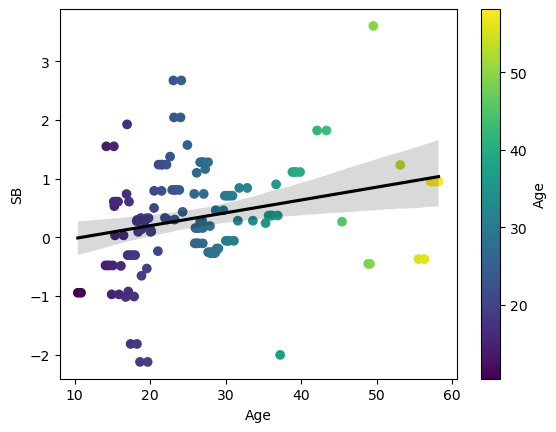

In [112]:
df_serial_bias_ext = df_serial_bias_ext.merge(age)
plt.scatter(df_serial_bias_ext['Age'],df_serial_bias_ext['SB'], c=df_serial_bias_ext['Age'], cmap='viridis')
plt.colorbar(label='Age')
sns.regplot(x='Age', y='SB', data=df_serial_bias_ext, scatter=False, color='black')


In [113]:
df_serial_bias_ext

,Unnamed: 0,group,Subject,session,SB,SB_diff,SB_par,SB_diff_par,Session,Birthdate,Testdate,M/F,Age,Group,sex
0,0,C,C03,4,0.461568,0.500720,1.244044,1.568705,1,1988-09-09 00:00:00,2017-05-18 00:00:00,F,28.69,C,F
1,0,C,C03,4,0.461568,0.500720,1.244044,1.568705,4,1988-09-09 00:00:00,2018-05-24 00:00:00,NaN,29.70,C,F
2,1,C,C05,1,1.573502,1.675930,3.569075,4.039286,4,1993-06-25 00:00:00,2018-05-31 00:00:00,F,24.93,C,F
3,2,C,C06,1,1.550943,1.515878,3.080607,3.078142,1,2003-04-10 00:00:00,2017-06-22 00:00:00,F,14.20,C,F
4,2,C,C06,1,1.550943,1.515878,3.080607,3.078142,4,2003-04-10 00:00:00,2018-06-21 00:00:00,NaN,15.20,C,F
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
126,62,S,S18,1,0.324480,0.639652,0.887068,1.478426,1,1999-10-06 00:00:00,2019-03-15 00:00:00,F,19.44,S,F
127,63,S,S19,1,0.500667,1.222393,-0.642922,0.188927,1,1998-10-16 00:00:00,2019-04-25 00:00:00,F,20.52,S,F
128,64,S,S20,1,3.603135,3.361217,7.312558,6.325829,1,1969-10-09 00:00:00,2019-04-24 00:00:00,F,49.54,S,F
129,65,S,S21,1,0.100379,0.314392,0.302389,1.224031,1,1999-04-13 00:00:00,2019-06-06 00:00:00,M,20.15,S,M


Text(0.5, 1.0, 'Serial bias vs SWSlope_Slope')

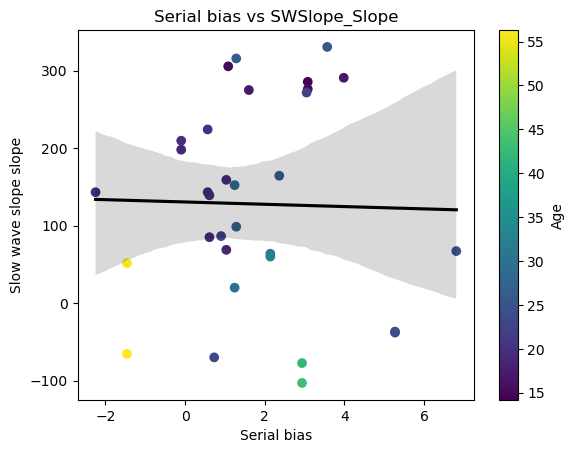

In [114]:

df_serial_age = pd.merge(df_serial_bias_ext, df_s_slopes, on='Age', how='inner')

plt.scatter(df_serial_age['SB_par'], df_serial_age['s_slope'], c=df_serial_age['Age'], cmap='viridis')
plt.colorbar(label='Age')
sns.regplot(x='SB_par', y='s_slope', data=df_serial_age, scatter=False, color='black')

plt.xlabel('Serial bias')
plt.ylabel('Slow wave slope slope')
plt.title('Serial bias vs SWSlope_Slope')


Text(0.5, 1.0, 'Serial bias vs SWSlope_Slope')

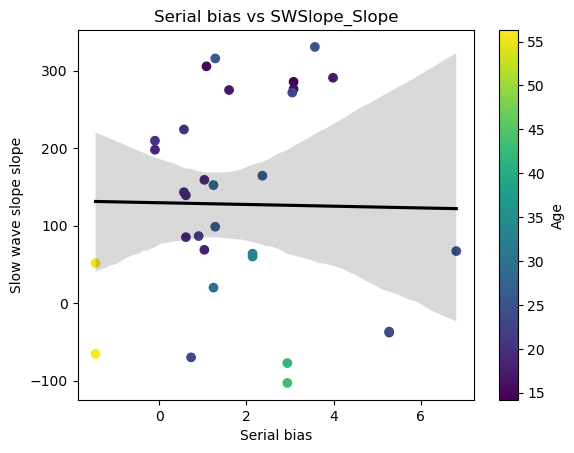

In [115]:
df_serial_age = df_serial_age[df_serial_age['group']=='C']

plt.scatter(df_serial_age['SB_par'], df_serial_age['s_slope'], c=df_serial_age['Age'], cmap='viridis')
plt.colorbar(label='Age')
sns.regplot(x='SB_par', y='s_slope', data=df_serial_age, scatter=False, color='black')

plt.xlabel('Serial bias')
plt.ylabel('Slow wave slope slope')
plt.title('Serial bias vs SWSlope_Slope')

Text(0.5, 1.0, 'Serial bias vs SWSlope_Slope')

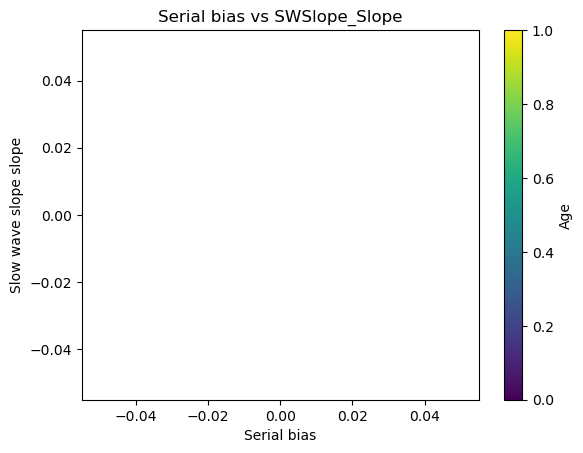

In [116]:
df_serial_age = df_serial_age[df_serial_age['group']=='E']

plt.scatter(df_serial_age['SB_par'], df_serial_age['s_slope'], c=df_serial_age['Age'], cmap='viridis')
plt.colorbar(label='Age')
sns.regplot(x='SB_par', y='s_slope', data=df_serial_age, scatter=False, color='black')

plt.xlabel('Serial bias')
plt.ylabel('Slow wave slope slope')
plt.title('Serial bias vs SWSlope_Slope')

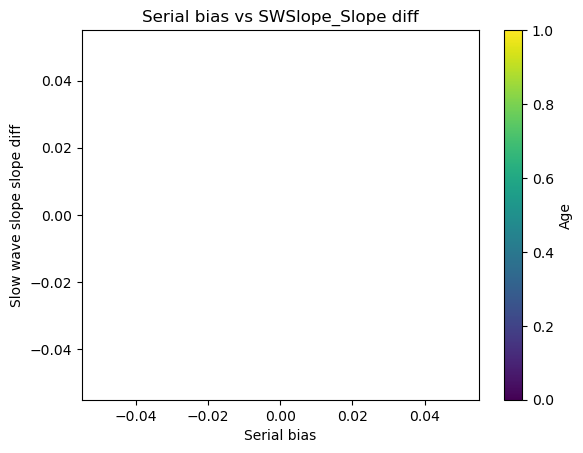

In [117]:
df_serial_age['slope_diff'] = (
    df_serial_age['s_slope'] - (total_coefs[2] - total_coefs[3] * np.exp(-df_serial_age['Age'] / total_coefs[4])) 
)
import seaborn as sns

plt.scatter(df_serial_age['SB'], df_serial_age['slope_diff'], c=df_serial_age['Age'], cmap='viridis')
plt.colorbar(label='Age')
sns.regplot(x='SB', y='slope_diff', data=df_serial_age, scatter=False, color='black')

plt.xlabel('Serial bias')
plt.ylabel('Slow wave slope slope diff')
plt.title('Serial bias vs SWSlope_Slope diff')
plt.show()

In [118]:
age

,Subject,Session,Birthdate,Testdate,M/F,Age,Group,sex
0,C02,1,1994-05-28 00:00:00,2017-04-26 00:00:00,F,22.91,C,F
1,C03,1,1988-09-09 00:00:00,2017-05-18 00:00:00,F,28.69,C,F
2,C04,1,1987-05-24 00:00:00,2017-06-08 00:00:00,F,30.04,C,F
3,C06,1,2003-04-10 00:00:00,2017-06-22 00:00:00,F,14.20,C,F
4,C07,1,1994-06-05 00:00:00,2017-07-05 00:00:00,F,23.08,C,F
...,...,...,...,...,...,...,...,...
160,S07,4,2002-06-21 00:00:00,2019-03-28 00:00:00,NaN,16.77,S,NaN
161,S08,4,2003-05-09 00:00:00,2019-03-27 00:00:00,NaN,15.88,S,F
162,S11,4,2003-05-15 00:00:00,2019-11-07 00:00:00,NaN,16.48,S,M
163,S12,4,1998-03-04 00:00:00,2019-09-05 00:00:00,NaN,21.51,S,F


67606


[]

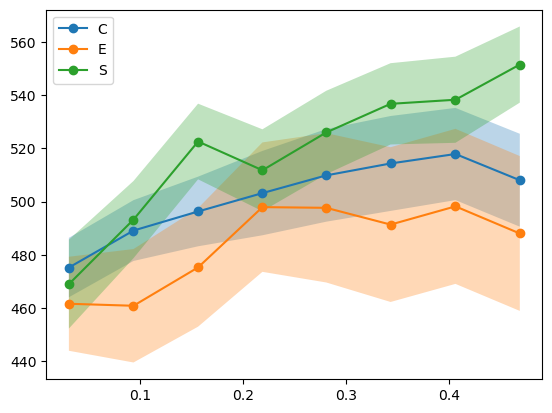

In [119]:
bins_data_F = data_allF.copy()
bins_data_F = bins_data_F[bins_data_F['Session']==1]
bins_data_F['time_rel'] = pd.cut(bins_data_F['time_rel'], bins=8)  
print (len(bins_data_F))

bdf = bins_data_F.groupby(['Session','Subject','time_rel'])['Slope'].mean().reset_index()
bdf['Group'] = bdf['Subject'].str[0]
bdf["time_rel_c"] = bdf["time_rel"].apply(lambda x: x.mid)
time_intervals = bdf['time_rel_c'].unique()
age_1 = age[age['Session']==1]
bdf = bdf.merge(age)

mdf = bdf.groupby(['Group','time_rel'])['Slope'].agg(['mean', 'sem']).reset_index()


for name, group in mdf.groupby('Group'):
    plt.plot(time_intervals, group['mean'], marker='o', label=name)
    plt.fill_between(time_intervals, group['mean'] - group['sem'],
                     group['mean'] + group['sem'], alpha=0.3)
plt.legend()
plt.plot()



61519


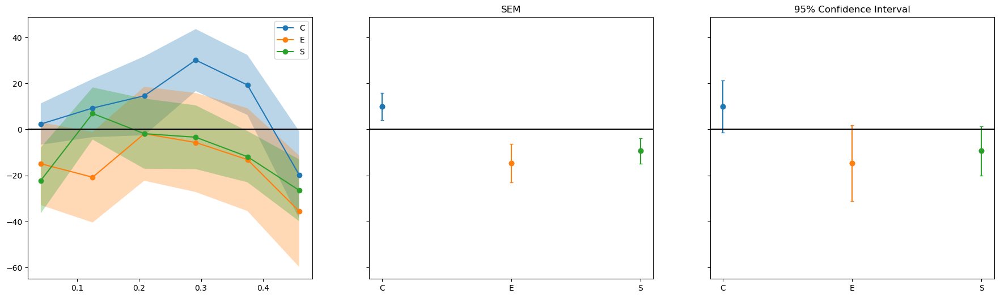

In [120]:
bins_data_F = data_allF.copy()
bins_data_F = bins_data_F[(bins_data_F['Session'] == 1) | ((bins_data_F['Group'] == 'E') & (bins_data_F['Session'] == 2))]
bins_data_F = bins_data_F[(bins_data_F['Age'] < 28)]
bins_data_F['time_rel'] = pd.cut(bins_data_F['time_rel'], bins=6)  
print (len(bins_data_F))

bdf = bins_data_F.groupby(['Session','Subject','time_rel'])['Slope'].mean().reset_index()
bdf['Group'] = bdf['Subject'].str[0]
bdf["time_rel_c"] = bdf["time_rel"].apply(lambda x: x.mid)
time_intervals = bdf['time_rel_c'].unique()
bdf = bdf.merge(age)

bdf['Age'] = pd.to_numeric(bdf['Age'], errors='coerce')
bdf['time_rel_c'] = pd.to_numeric(bdf['time_rel_c'], errors='coerce')

bdf['Slope_n'] = (
    total_coefs[0] +
    total_coefs[1] * bdf['Age'] +
    (total_coefs[2] - total_coefs[3] * np.exp(-bdf['Age'] / total_coefs[4])) * bdf['time_rel_c']
)

bdf['Slope_rel'] = bdf['Slope'] - bdf['Slope_n']

mdf = bdf.groupby(['Group', 'time_rel'])['Slope_rel'].agg(['mean', 'sem']).reset_index()
mdf_t = bdf.groupby(['Group'])['Slope_rel'].agg(['mean', 'sem']).reset_index()

# Plotting
fig, ax = plt.subplots(1, 3, figsize = (22, 6),sharey=True)
for name, group in mdf.groupby('Group'):
    ax[0].plot(time_intervals, group['mean'], marker='o', label=name)
    if name == 'C':
        diff_c = (group['mean'],group['sem'])
    if name == 'E':
        diff_e = (group['mean'],group['sem'])
    if name == 'S':
        diff_s = (group['mean'],group['sem'])

    ax[0].fill_between(time_intervals, group['mean'] - group['sem'],
                     group['mean'] + group['sem'], alpha=0.3)

ax[0].axhline(0, color='black')
ax[0].legend()

for name, group in mdf_t.groupby('Group'):
    ax[1].scatter(name,group['mean'])
    ax[1].errorbar(name, group['mean'], yerr=group['sem'],capsize=2, marker="o")
ax[1].axhline(0, color='black')
ax[1].set_title('SEM')

for name, group in mdf_t.groupby('Group'):
    ax[2].scatter(name,group['mean'])
    ax[2].errorbar(name, group['mean'], yerr=group['sem']*1.96,capsize=2, marker="o")
ax[2].axhline(0, color='black')
ax[2].set_title('95% Confidence Interval')
plt.show()


In [121]:
group

,Group,mean,sem
2,S,-9.327947,5.467511


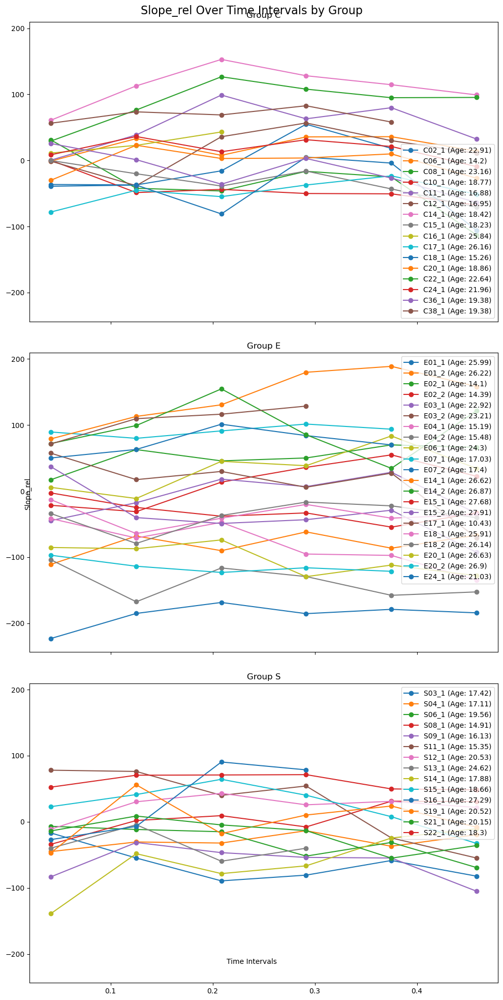

In [122]:
colors = {'C': 'blue', 'E': 'orange', 'S': 'green'}

bdf['Id'] = bdf['Subject'] + '_' + bdf['Session'].astype(str)

fig, axs = plt.subplots(len(colors), 1, figsize=(10, 20), sharex=True, sharey=True)
fig.subplots_adjust(hspace=0.3)  # Adjust vertical space between subplots

for i, (group, color) in enumerate(colors.items()):
    # Filter data for current group
    group_data = bdf[bdf['Group'] == group]
    
    # Plot data in the i-th subplot
    for name, subject in group_data.groupby('Id'):
        axs[i].plot(time_intervals, subject['Slope_rel'], marker='o', label=f"{name} (Age: {subject['Age'].unique()[0]})")
    
    # Set title and legend for the subplot
    axs[i].set_title(f'Group {group}')
    axs[i].legend()

# Set common labels and title for all subplots
fig.text(0.5, 0.04, 'Time Intervals', ha='center', va='center')
fig.text(0.06, 0.5, 'Slope_rel', ha='center', va='center', rotation='vertical')
fig.suptitle('Slope_rel Over Time Intervals by Group', fontsize=16)

# Adjust layout and display the plot
plt.tight_layout()
plt.show()

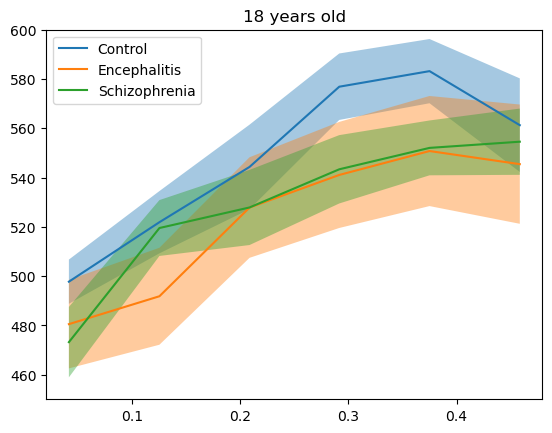

In [123]:
age_y = 18
time_intervals

Slope_pred_y = total_coefs[0] + total_coefs[1] * age_y + (total_coefs[2] - total_coefs[3] * np.exp(-age_y/ total_coefs[4])) * time_intervals.astype(float)
Slope_pred_cy = Slope_pred_y + diff_c[0]
Slope_pred_ey = Slope_pred_y + diff_e[0]
Slope_pred_sy = Slope_pred_y + diff_s[0]

plt.title('18 years old')
plt.plot(time_intervals, Slope_pred_cy, label = 'Control')
plt.fill_between(time_intervals, Slope_pred_cy + diff_c[1],Slope_pred_cy - diff_c[1],alpha=0.4)
plt.plot(time_intervals, Slope_pred_ey, label = 'Encephalitis')
plt.fill_between(time_intervals, Slope_pred_ey + diff_e[1],Slope_pred_ey - diff_e[1],alpha=0.4)
plt.plot(time_intervals, Slope_pred_sy, label = 'Schizophrenia')
plt.fill_between(time_intervals, Slope_pred_sy + diff_s[1],Slope_pred_sy - diff_s[1],alpha=0.4)
plt.ylim([450,600])
plt.legend()
plt.show()





In [124]:

model = Lmer('Slope_rel ~ time_rel_c*Age*Group + (1|Id)', data=bdf)
model.fit()



print(model.coefs)

**NOTE**: Column for 'residuals' not created in model.data, but saved in model.resid only. This is because you have rows with NaNs in your data.

**NOTE** Column for 'fits' not created in model.data, but saved in model.fits only. This is because you have rows with NaNs in your data.

Linear mixed model fit by REML [’lmerMod’]
Formula: Slope_rel~time_rel_c*Age*Group+(1|Id)

Family: gaussian	 Inference: parametric

Number of observations: 306	 Groups: {'Id': 50.0}

Log-likelihood: -1418.814 	 AIC: 2865.627

Random effects:

                 Name       Var     Std
Id        (Intercept)  4452.057  66.724
Residual                905.919  30.098

No random effect correlations specified

Fixed effects:

                         Estimate      2.5_ci     97.5_ci          SE  \
(Intercept)             46.368207 -161.234098  253.970512  105.921490   
time_rel_c             -51.890730 -326.027064  222.245604  139.868047   
Age                     -1.702656  -11.973054    8.567742    5.240095   
Gr

/home/amoran/miniconda3/envs/yasa_env/lib/python3.11/site-packages/rpy2/robjects/pandas2ri.py:65: UserWarning: Error while trying to convert the column "time_rel". Fall back to string conversion. The error is: Converting pandas "Category" series to R factor is only possible when categories are strings.
  warnings.warn('Error while trying to convert '
/home/amoran/miniconda3/envs/yasa_env/lib/python3.11/site-packages/rpy2/robjects/pandas2ri.py:65: UserWarning: Error while trying to convert the column "Birthdate". Fall back to string conversion. The error is: <class 'pandas._libs.tslibs.timestamps.Timestamp'>
  warnings.warn('Error while trying to convert '
/home/amoran/miniconda3/envs/yasa_env/lib/python3.11/site-packages/rpy2/robjects/pandas2ri.py:65: UserWarning: Error while trying to convert the column "Testdate". Fall back to string conversion. The error is: <class 'pandas._libs.tslibs.timestamps.Timestamp'>
  warnings.warn('Error while trying to convert '


In [125]:
# DATA

# x is a matrix one column per participant, one row per time  70 * 8
# age is a vector of 70 * 1 values
# group is a matrix of one column per participant, 70 * 3 rows (is_control, is_enc, is_sq)

# X is a matrix with all data above:  70 * 12(8+1+3) 

# PARAMETERS
# mi is a vector of 70 values
# mage is a scalar
# mgroup is a vector of 3 values (control, enc, sq)


# Y = 8*70



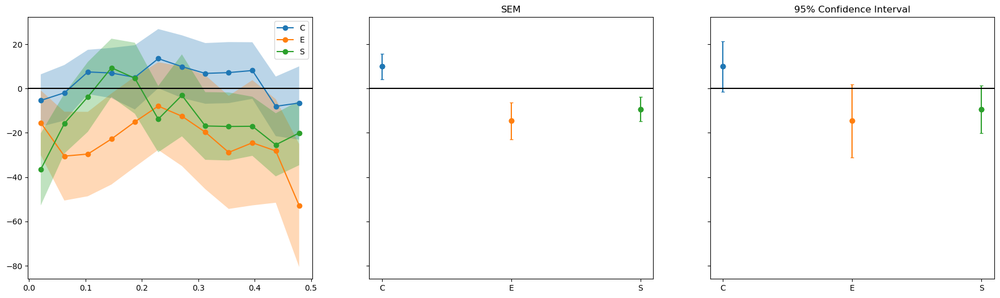

In [126]:
daf = data_allF.copy()
daf = daf[daf['Session']==1]
daf['Slope_n'] = (
    total_coefs[0] +
    total_coefs[1] * daf['Age'] +
    (total_coefs[2] - total_coefs[3] * np.exp(-daf['Age'] / total_coefs[4])) * daf['time_rel']
)

daf['Slope_rel'] = daf['Slope'] - daf['Slope_n']
bdaf = daf.copy()
bdaf['time_rel'] = pd.cut(bdaf['time_rel'], bins=12)  
bdaf = bdaf.groupby(['Session','Subject','time_rel'])['Slope_rel'].mean().reset_index()
bdaf['Group'] = bdaf['Subject'].str[0]
bdaf["time_rel_c"] = bdaf["time_rel"].apply(lambda x: x.mid)
time_intervals = bdaf['time_rel_c'].unique()
age_1 = age[age['Session']==1]
bdaf = bdaf.merge(age)

bdaf['Age'] = pd.to_numeric(bdaf['Age'], errors='coerce')
bdaf['time_rel_c'] = pd.to_numeric(bdaf['time_rel_c'], errors='coerce')

mdaf = bdaf.groupby(['Group', 'time_rel'])['Slope_rel'].agg(['mean', 'sem']).reset_index()

# Plotting
fig, ax = plt.subplots(1, 3, figsize = (22, 6),sharey=True)
for name, group in mdaf.groupby('Group'):
    ax[0].plot(time_intervals, group['mean'], marker='o', label=name)
    ax[0].fill_between(time_intervals, group['mean'] - group['sem'],
                     group['mean'] + group['sem'], alpha=0.3)

ax[0].axhline(0, color='black')
ax[0].legend()

for name, group in mdf_t.groupby('Group'):
    ax[1].scatter(name,group['mean'])
    ax[1].errorbar(name, group['mean'], yerr=group['sem'],capsize=2, marker="o")
ax[1].axhline(0, color='black')
ax[1].set_title('SEM')

for name, group in mdf_t.groupby('Group'):
    ax[2].scatter(name,group['mean'])
    ax[2].errorbar(name, group['mean'], yerr=group['sem']*1.96,capsize=2, marker="o")
ax[2].axhline(0, color='black')
ax[2].set_title('95% Confidence Interval')
plt.show()


In [127]:
mdaf.head()


,Group,time_rel,mean,sem
0,C,"(-0.0005, 0.0417]",-5.386260,11.784975
1,C,"(0.0417, 0.0833]",-1.935892,12.554929
2,C,"(0.0833, 0.125]",7.481016,9.995891
3,C,"(0.125, 0.167]",7.008146,11.343142
4,C,"(0.167, 0.208]",5.046737,14.508402


In [128]:
mdf.head()


,Group,time_rel,mean,sem
0,C,"(-0.0005, 0.0833]",2.339739,8.969340
1,C,"(0.0833, 0.167]",9.293326,12.635974
2,C,"(0.167, 0.25]",14.618010,17.144093
3,C,"(0.25, 0.333]",30.136416,13.484195
4,C,"(0.333, 0.417]",19.317956,13.030413


In [129]:
model = Lmer('Slope_rel ~ time_rel*Age*Group + (1|Subject)', data=daf)
model.fit()


print(model.coefs)

/home/amoran/miniconda3/envs/yasa_env/lib/python3.11/site-packages/rpy2/robjects/pandas2ri.py:65: UserWarning: Error while trying to convert the column "ConfArousal". Fall back to string conversion. The error is: Converting pandas "Category" series to R factor is only possible when categories are strings.
  warnings.warn('Error while trying to convert '


Linear mixed model fit by REML [’lmerMod’]
Formula: Slope_rel~time_rel*Age*Group+(1|Subject)

Family: gaussian	 Inference: parametric

Number of observations: 67606	 Groups: {'Subject': 64.0}

Log-likelihood: -450800.910 	 AIC: 901629.820

Random effects:

                 Name        Var      Std
Subject   (Intercept)   4493.072   67.030
Residual               36125.790  190.068

No random effect correlations specified

Fixed effects:

                       Estimate      2.5_ci     97.5_ci         SE  \
(Intercept)           17.591246  -37.792899   72.975391  28.257736   
time_rel              -3.878841  -39.067010   31.309327  17.953477   
Age                   -0.394369   -1.929762    1.141025   0.783379   
GroupE                23.899321  -87.024547  134.823189  56.594850   
GroupS                30.902825 -121.226520  183.032171  77.618439   
time_rel:Age           0.386403   -0.686349    1.459154   0.547332   
time_rel:GroupE       10.105130  -65.971160   86.181420  38.815147   

In [130]:
bdf.head()



,Session,Subject,time_rel,Slope,Group,time_rel_c,Birthdate,Testdate,M/F,Age,sex,Slope_n,Slope_rel,Id
0,1,C02,"(-0.0005, 0.0833]",451.427524,C,0.04140,1994-05-28 00:00:00,2017-04-26 00:00:00,F,22.91,F,487.845898,-36.418373,C02_1
1,1,C02,"(0.0833, 0.167]",461.897149,C,0.12515,1994-05-28 00:00:00,2017-04-26 00:00:00,F,22.91,F,498.927331,-37.030182,C02_1
2,1,C02,"(0.167, 0.25]",494.219918,C,0.20850,1994-05-28 00:00:00,2017-04-26 00:00:00,F,22.91,F,509.955838,-15.735920,C02_1
3,1,C02,"(0.25, 0.333]",575.735571,C,0.29150,1994-05-28 00:00:00,2017-04-26 00:00:00,F,22.91,F,520.938035,54.797536,C02_1
4,1,C02,"(0.333, 0.417]",550.220247,C,0.37500,1994-05-28 00:00:00,2017-04-26 00:00:00,F,22.91,F,531.986390,18.233857,C02_1


 _____________ Fitted Parameters A:
a: 481.23051812093064
b: -14999.999999999998
c: 4.667068459783748
 _____________ Fitted Parameters B:
a: 47.567767405035774
b: -14999.999999999998
c: 4.765565390319493
 _____________ Fitted Parameters C:
a: 2.013490173804411
b: -3.031108478526913e-12
c: 999.99999999989


/home/amoran/miniconda3/envs/yasa_env/lib/python3.11/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


Text(0.5, 0.98, 'Slope analysis')

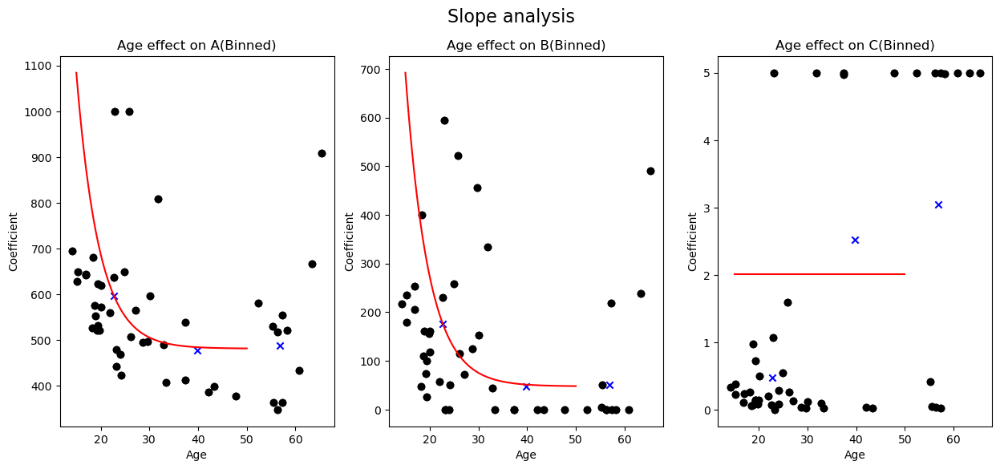

In [131]:

#LOG NO BINS


daf_c = data_allF[data_allF['Group']=='C']


#CONTROL SWA found

daf_c = daf_c[daf_c['Subject'].isin(daf_c['Subject'].value_counts()[daf_c['Subject'].value_counts() >= 20].index)]


daf_c['sAge'] = daf_c['Age']/50


def func(x, a, b, c):
    return a  - (b * np.exp(-x/c)) 




x_list = []
a_list = []
b_list = []
c_list = []



for name, Subject in daf_c.groupby('Id'):
    #plt.scatter(Subject.time_rel.values,Subject.Slope.values)
    x = Subject.time_rel.values
    y = Subject.Slope.values
      
    popt, pcov = curve_fit(func, x, y,bounds=([0,0,0],[1000,1000,5]))

    #plt.plot(x, func(x,popt[0],popt[1],popt[2]))
    coef_a = popt[0]
    coef_b = popt[1]
    coef_c = popt[2]
    

    x_list.append(Subject['Age'].unique()[0])
    a_list.append(coef_a)
    b_list.append(coef_b)
    c_list.append(coef_c)
   

fig, ax = plt.subplots(1, 3, figsize = (15, 6))


splot = 0
coef_names = ['A','B','C']

for coef_list in [a_list,b_list,c_list]:
    y_list = coef_list

    ax[splot].scatter(x_list, y_list, marker='o', c='black', label='individual B predictions')

    sorted_data = sorted(zip(x_list, y_list))
    x_sorted, y_sorted = zip(*sorted_data)
    x_sorted = np.array(x_sorted)
    y_sorted = np.array(y_sorted)


    num_bins = 3
    bin_edges = np.linspace(min(x_sorted), max(x_sorted), num_bins + 1)
    bin_indices = np.digitize(x_sorted, bin_edges)

    bin_means = [y_sorted[bin_indices == i].mean() for i in range(1, num_bins + 1)]
    bin_centers = [np.mean([bin_edges[i],bin_edges[i+1]]) for i in range(0, num_bins)]

    popt_t_bin, pcov_t_bin = curve_fit(func, bin_centers, bin_means, bounds=([-10000, -15000, 0], [10000, 0, 1000]))

    print(" _____________ Fitted Parameters " + coef_names[splot]+":")
    print("a:", popt_t_bin[0])
    print("b:", popt_t_bin[1])
    print("c:", popt_t_bin[2])
    


    x_ages = np.linspace(15,50,200)

    ax[splot].scatter(x_sorted, y_sorted, marker='o', c='black', label='Individual B predictions')
    ax[splot].scatter(bin_centers, bin_means, marker='x', c='blue', label='Mean values per bin')
    ax[splot].plot(x_ages, func(x_ages, popt_t_bin[0], popt_t_bin[1], popt_t_bin[2]), c='red', label='Exponential prediction')

    ax[splot].set_title('Age effect on ' + coef_names[splot] +'(Binned)')
    ax[splot].set_xlabel('Age')
    ax[splot].set_ylabel('Coefficient')
    


    splot = splot + 1


fig.suptitle("Slope analysis", fontsize=16)



 _____________ Fitted Parameters A:
a: 92.21034721162313
b: -193.5446333880351
c: 19.086113182713706
 _____________ Fitted Parameters B:
a: -20.758120203126143
b: -204.79303917594598
c: 19.545366637719358
 _____________ Fitted Parameters C:
a: -25.965168854080964
b: -28.835315863473745
c: 999.9999999997713


Text(0.5, 0.98, 'Amplitude analysis')

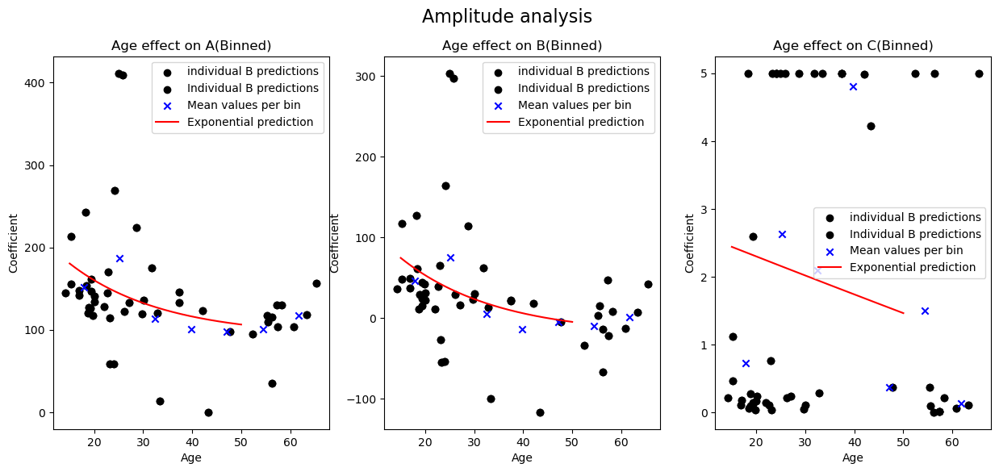

In [132]:
#LOG NO BINS AMPLITUDE


daf_c = data_allF[data_allF['Group']=='C']


#CONTROL SWA found

daf_c = daf_c[daf_c['Subject'].isin(daf_c['Subject'].value_counts()[daf_c['Subject'].value_counts() >= 20].index)]


daf_c['sAge'] = daf_c['Age']/50


def func(x, a, b, c):
    return a  - (b * np.exp(-x/c))


x_list = []
a_list = []
b_list = []
c_list = []



for name, Subject in daf_c.groupby('Id'):
    #plt.scatter(Subject.time_rel.values,Subject.Slope.values)
    x = Subject.time_rel.values
    y = Subject.PTP.values
      
    popt, pcov = curve_fit(func, x, y,bounds=([0,-1000,0],[1000,1000,5]))

    #plt.plot(x, func(x,popt[0],popt[1],popt[2]))
    coef_a = popt[0]
    coef_b = popt[1]
    coef_c = popt[2]

    x_list.append(Subject['Age'].unique()[0])
    a_list.append(coef_a)
    b_list.append(coef_b)
    c_list.append(coef_c)

fig, ax = plt.subplots(1, 3, figsize = (15, 6))




splot = 0
coef_names = ['A','B','C']

for coef_list in [a_list,b_list,c_list]:
    y_list = coef_list

    ax[splot].scatter(x_list, y_list, marker='o', c='black', label='individual B predictions')

    sorted_data = sorted(zip(x_list, y_list))
    x_sorted, y_sorted = zip(*sorted_data)
    x_sorted = np.array(x_sorted)
    y_sorted = np.array(y_sorted)


    num_bins = 7
    bin_edges = np.linspace(min(x_sorted), max(x_sorted), num_bins + 1)
    bin_indices = np.digitize(x_sorted, bin_edges)

    bin_means = [y_sorted[bin_indices == i].mean() for i in range(1, num_bins + 1)]
    bin_centers = [np.mean([bin_edges[i],bin_edges[i+1]]) for i in range(0, num_bins)]

    popt_t_bin, pcov_t_bin = curve_fit(func, bin_centers, bin_means, bounds=([-10000, -15000, 0], [10000, 0, 1000]))

    print(" _____________ Fitted Parameters " + coef_names[splot]+":")
    print("a:", popt_t_bin[0])
    print("b:", popt_t_bin[1])
    print("c:", popt_t_bin[2])

    x_ages = np.linspace(15,50,200)

    ax[splot].scatter(x_sorted, y_sorted, marker='o', c='black', label='Individual B predictions')
    ax[splot].scatter(bin_centers, bin_means, marker='x', c='blue', label='Mean values per bin')
    ax[splot].plot(x_ages, func(x_ages, popt_t_bin[0], popt_t_bin[1], popt_t_bin[2]), c='red', label='Exponential prediction')

    ax[splot].set_title('Age effect on ' + coef_names[splot] +'(Binned)')
    ax[splot].set_xlabel('Age')
    ax[splot].set_ylabel('Coefficient')
    ax[splot].legend()


    splot = splot + 1


fig.suptitle("Amplitude analysis", fontsize=16)


 _____________ Fitted Parameters A:
a: 233.7087760917485
b: -8.716878206405576e-07
c: 999.856523325933
 _____________ Fitted Parameters B:
a: -3742.126039065802
b: -4125.315229448944
c: 999.9999999999999
 _____________ Fitted Parameters C:
a: 0.2280810379576131
b: -8.954122130924673e-11
c: 999.9999999926349


Text(0.5, 0.98, 'Amplitude analysis')

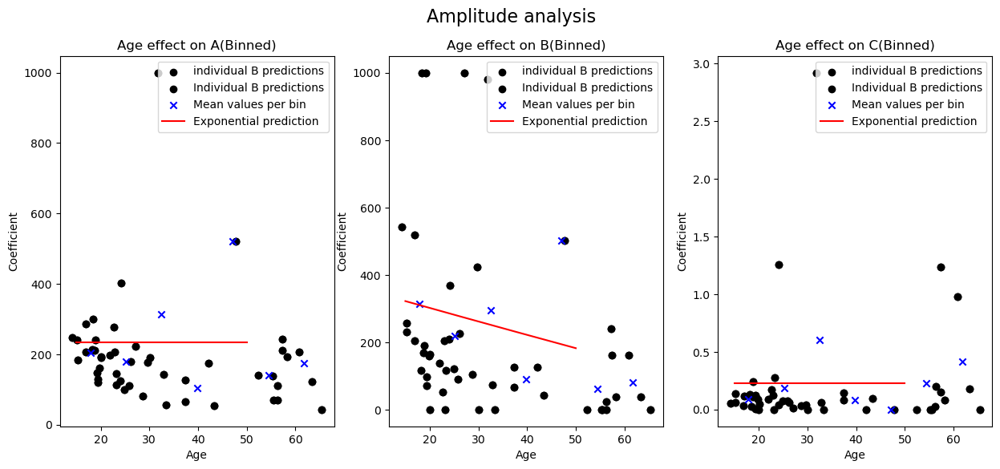

In [133]:
#LOG NO BINS NUMBER


daf_c = data_allF[data_allF['Group']=='C']


#CONTROL SWA found

daf_c = daf_c[daf_c['Subject'].isin(daf_c['Subject'].value_counts()[daf_c['Subject'].value_counts() >= 20].index)]


daf_c['sAge'] = daf_c['Age']/50


def func(x, a, b, c):
    return a  - (b * np.exp(-x/c))


x_list = []
a_list = []
b_list = []
c_list = []



for name, Subject in daf_c.groupby('Id'):
    #plt.scatter(Subject.time_rel.values,Subject.Slope.values)

    bins_Subject = Subject.copy()
    bins_Subject['time_rel'] = pd.cut(bins_Subject['time_rel'], bins=8)  # Adjust the number of bins as needed
    bins_Subject = bins_Subject.groupby(['Session','Subject','time_rel'])['Slope'].count().reset_index()
    bdf_c['Group'] = bdf_c['Subject'].str[0]
    bins_Subject["time_rel_c"] = bins_Subject["time_rel"].apply(lambda x: x.mid).astype('object')
    times_Subject = bins_Subject['time_rel_c'].unique()
    
    x = bins_Subject.time_rel_c.values
    y = bins_Subject.Slope.values
      
    popt, pcov = curve_fit(func, x, y,bounds=([0,0,0],[1000,1000,5]))

    if popt[2] > 4:
        popt[2] = 0

    #plt.plot(x, func(x,popt[0],popt[1],popt[2]))
    coef_a = popt[0]
    coef_b = popt[1]
    coef_c = popt[2]

    x_list.append(Subject['Age'].unique()[0])
    a_list.append(coef_a)
    b_list.append(coef_b)
    c_list.append(coef_c)

fig, ax = plt.subplots(1, 3, figsize = (15, 6))




splot = 0
coef_names = ['A','B','C']

for coef_list in [a_list,b_list,c_list]:
    y_list = coef_list

    ax[splot].scatter(x_list, y_list, marker='o', c='black', label='individual B predictions')

    sorted_data = sorted(zip(x_list, y_list))
    x_sorted, y_sorted = zip(*sorted_data)
    x_sorted = np.array(x_sorted)
    y_sorted = np.array(y_sorted)


    num_bins = 7
    bin_edges = np.linspace(min(x_sorted), max(x_sorted), num_bins + 1)
    bin_indices = np.digitize(x_sorted, bin_edges)

    bin_means = [y_sorted[bin_indices == i].mean() for i in range(1, num_bins + 1)]
    bin_centers = [np.mean([bin_edges[i],bin_edges[i+1]]) for i in range(0, num_bins)]

    popt_t_bin, pcov_t_bin = curve_fit(func, bin_centers, bin_means, bounds=([-10000, -15000, 0], [10000, 0, 1000]))

    print(" _____________ Fitted Parameters " + coef_names[splot]+":")
    print("a:", popt_t_bin[0])
    print("b:", popt_t_bin[1])
    print("c:", popt_t_bin[2])

    x_ages = np.linspace(15,50,200)

    ax[splot].scatter(x_sorted, y_sorted, marker='o', c='black', label='Individual B predictions')
    ax[splot].scatter(bin_centers, bin_means, marker='x', c='blue', label='Mean values per bin')
    ax[splot].plot(x_ages, func(x_ages, popt_t_bin[0], popt_t_bin[1], popt_t_bin[2]), c='red', label='Exponential prediction')

    ax[splot].set_title('Age effect on ' + coef_names[splot] +'(Binned)')
    ax[splot].set_xlabel('Age')
    ax[splot].set_ylabel('Coefficient')
    ax[splot].legend()


    splot = splot + 1


fig.suptitle("Amplitude analysis", fontsize=16)

NAN
NAN
NAN
NAN
NAN
NAN
NAN
NAN
NAN
NAN
NAN
NAN
NAN
NAN
NAN
NAN
NAN
NAN
NAN
NAN
NAN
NAN
NAN
NAN
NAN
NAN
NAN
NAN
NAN
NAN
NAN
NAN
NAN
NAN
NAN
NAN
NAN
NAN
NAN
NAN
NAN
NAN
NAN
NAN
NAN
NAN
NAN
NAN
NAN
NAN
NAN
NAN
NAN


[]

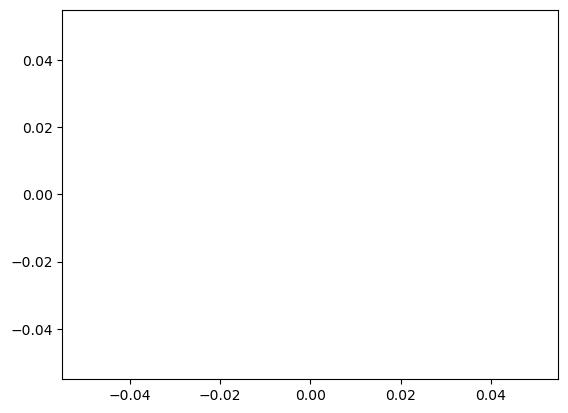

In [134]:
#LOG WITH BINS




#CONTROL SWA found

bdf_c = bdf_c

bdf_c['Id'] = bdf_c['Subject'] + '_' + bdf_c['Session'].astype(str)
bdf_c['sAge'] = bdf_c['Age']/50


def func(x, a, b, c):

    return a  + (b * np.exp(-x/c))


for name, Subject in bdf_c.groupby('Id'):
    #plt.scatter(Subject.time_rel.values,Subject.Slope.values)
    x = Subject.time_rel_c.values
    y = Subject.Slope.values
    
    try:
        popt, pcov = curve_fit(func, x, y)
    

        #plt.plot(x, func(x,popt[0],popt[1],popt[2]))
        coef = popt[1]
        #age = Subject['sAge'].unique()[0]
        plt.scatter(age,coef, color='black')

    except:
        print('NAN')

    #print(Subject['sAge'].unique()[0])
    #print(coef)
   
    
    
plt.plot()

C48_1
[0.0414 0.12515 0.20850000000000002 0.2915 0.375 0.4585]
338802.993441295
-338388.9565328277
2620.309784350853


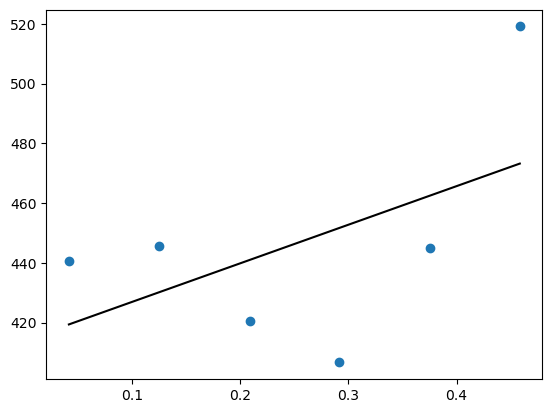

In [135]:
print(name)
plt.scatter(Subject.time_rel_c,Subject.Slope.values)
print(x)
print(popt[0])
print(popt[1])
print(popt[2])
x = Subject.time_rel_c.values.astype(float)
plt.plot(x, func(x,popt[0],popt[1],popt[2]), color='black')

## SQRT PRED PLOT

In [136]:
daf_c = data_allF[data_allF['Group']=='C']


#CONTROL SWA found

daf_c = daf_c[daf_c['Subject'].isin(daf['Subject'].value_counts()[daf_c['Subject'].value_counts() >= 20].index)]

daf_c['Id'] = daf_c['Subject'] + '_' + daf_c['Session'].astype(str)
daf_c['sAge'] = daf_c['Age']/50
daf_c['sAge2'] = daf_c['sAge']**2
daf_c['sAge3'] = daf_c['sAge']**3
daf_c['sAge4'] = daf_c['sAge']**4
daf_c['sqrt_t'] = np.sqrt(daf_c['time_rel'])
sAge_values = np.arange(0.2,1,0.01)
sAge_values2 = sAge_values**2
sAge_values3 = sAge_values**3
sAge_values4 = sAge_values**4


for name, Subject in daf_c.groupby('Id'):
    model_id = Lm('Slope ~ sqrt_t', data=Subject)
    result = model_id.fit()
    coef = result['Estimate'][1]
    #age = Subject['sAge'].unique()[0]
    plt.scatter(age,coef, color='black')

#Sqrt deg 1:

model1 = Lm('Slope ~ sqrt_t * (sAge)', data=daf_c)
model1.fit()
plt.plot(sAge_values, model1.coefs['Estimate'][1] 
                                                + model1.coefs['Estimate'][3]*sAge_values 
                                                ,label = 'deg1')

#Sqrt deg 2:

model2 = Lm('Slope ~ sqrt_t * (sAge + sAge2)', data=daf_c)
model2.fit()
plt.plot(sAge_values, model2.coefs['Estimate'][1] 
                                                + model2.coefs['Estimate'][4]*sAge_values 
                                                + model2.coefs['Estimate'][5]*sAge_values2 
                                                ,label = 'deg2')

#Sqrt deg 3:

model3 = Lm('Slope ~ sqrt_t * (sAge + sAge2 + sAge3)', data=daf_c)
model3.fit()
plt.plot(sAge_values, model3.coefs['Estimate'][1] 
                                                + model3.coefs['Estimate'][5]*sAge_values
                                                + model3.coefs['Estimate'][6]*sAge_values2
                                                + model3.coefs['Estimate'][7]*sAge_values3
                                                ,label = 'deg3')


#Sqrt deg 4:

model4 = Lm('Slope ~ sqrt_t * (sAge + sAge2 + sAge3 + sAge4)', data=daf_c)
model4.fit()
plt.plot(sAge_values, model4.coefs['Estimate'][1] 
                                                + model4.coefs['Estimate'][6]*sAge_values 
                                                + model4.coefs['Estimate'][7]*sAge_values2
                                                + model4.coefs['Estimate'][8]*sAge_values3
                                                + model4.coefs['Estimate'][9]*sAge_values4
                                                ,label = 'deg4')

plt.ylim([-300,700])
plt.legend()
plt.show()





IndexingError: Unalignable boolean Series provided as indexer (index of the boolean Series and of the indexed object do not match).

## LINE PRED PLOT

/tmp/ipykernel_2747101/2835078309.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  daf_c['Id'] = daf_c['Subject'] + '_' + daf_c['Session'].astype(str)
/tmp/ipykernel_2747101/2835078309.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  daf_c['sAge'] = daf_c['Age']/50
/tmp/ipykernel_2747101/2835078309.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://panda

Formula: Slope~time_rel

Family: gaussian	 Estimator: OLS

Std-errors: non-robust	CIs: standard 95%	Inference: parametric 

Number of observations: 2047	 R^2: 0.001	 R^2_adj: 0.000

Log-likelihood: -13446.054 	 AIC: 26896.108	 BIC: 26907.356

Fixed effects:

Formula: Slope~time_rel

Family: gaussian	 Estimator: OLS

Std-errors: non-robust	CIs: standard 95%	Inference: parametric 

Number of observations: 902	 R^2: 0.003	 R^2_adj: 0.001

Log-likelihood: -5807.964 	 AIC: 11619.929	 BIC: 11629.538

Fixed effects:

Formula: Slope~time_rel

Family: gaussian	 Estimator: OLS

Std-errors: non-robust	CIs: standard 95%	Inference: parametric 

Number of observations: 466	 R^2: 0.003	 R^2_adj: 0.000

Log-likelihood: -2972.719 	 AIC: 5949.438	 BIC: 5957.726

Fixed effects:

Formula: Slope~time_rel

Family: gaussian	 Estimator: OLS

Std-errors: non-robust	CIs: standard 95%	Inference: parametric 

Number of observations: 2500	 R^2: 0.002	 R^2_adj: 0.001

Log-likelihood: -16762.757 	 AIC: 33529.515	 BI

/tmp/ipykernel_2747101/2835078309.py:17: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  coef = result['Estimate'][1]
/tmp/ipykernel_2747101/2835078309.py:17: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  coef = result['Estimate'][1]
/tmp/ipykernel_2747101/2835078309.py:17: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  coef = result['Estimate'][1]
/tmp/ipykernel_2747101/2835078309.py:17: FutureWarning: Series.__getitem__ treating keys

Formula: Slope~time_rel

Family: gaussian	 Estimator: OLS

Std-errors: non-robust	CIs: standard 95%	Inference: parametric 

Number of observations: 1130	 R^2: 0.000	 R^2_adj: -0.001

Log-likelihood: -7311.558 	 AIC: 14627.116	 BIC: 14637.176

Fixed effects:

Formula: Slope~time_rel

Family: gaussian	 Estimator: OLS

Std-errors: non-robust	CIs: standard 95%	Inference: parametric 

Number of observations: 1701	 R^2: 0.001	 R^2_adj: 0.001

Log-likelihood: -10866.761 	 AIC: 21737.521	 BIC: 21748.399

Fixed effects:

Formula: Slope~time_rel

Family: gaussian	 Estimator: OLS

Std-errors: non-robust	CIs: standard 95%	Inference: parametric 

Number of observations: 4434	 R^2: 0.024	 R^2_adj: 0.024

Log-likelihood: -29964.563 	 AIC: 59933.127	 BIC: 59945.921

Fixed effects:

Formula: Slope~time_rel

Family: gaussian	 Estimator: OLS

Std-errors: non-robust	CIs: standard 95%	Inference: parametric 

Number of observations: 2443	 R^2: 0.000	 R^2_adj: -0.000

Log-likelihood: -15994.865 	 AIC: 31993.

/tmp/ipykernel_2747101/2835078309.py:17: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  coef = result['Estimate'][1]
/tmp/ipykernel_2747101/2835078309.py:17: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  coef = result['Estimate'][1]
/tmp/ipykernel_2747101/2835078309.py:17: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  coef = result['Estimate'][1]
/tmp/ipykernel_2747101/2835078309.py:25: FutureWarning: Series.__getitem__ treating keys

Formula: Slope~time_rel*(sAge)

Family: gaussian	 Estimator: OLS

Std-errors: non-robust	CIs: standard 95%	Inference: parametric 

Number of observations: 70885	 R^2: 0.056	 R^2_adj: 0.056

Log-likelihood: -471102.749 	 AIC: 942213.498	 BIC: 942250.174

Fixed effects:

Formula: Slope~time_rel*(sAge+sAge2)

Family: gaussian	 Estimator: OLS

Std-errors: non-robust	CIs: standard 95%	Inference: parametric 

Number of observations: 70885	 R^2: 0.059	 R^2_adj: 0.059

Log-likelihood: -471007.692 	 AIC: 942027.384	 BIC: 942082.397

Fixed effects:

Formula: Slope~time_rel*(sAge+sAge2+sAge3)

Family: gaussian	 Estimator: OLS

Std-errors: non-robust	CIs: standard 95%	Inference: parametric 

Number of observations: 70885	 R^2: 0.061	 R^2_adj: 0.061

Log-likelihood: -470926.638 	 AIC: 941869.275	 BIC: 941942.626

Fixed effects:



/tmp/ipykernel_2747101/2835078309.py:42: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  plt.plot(sAge_values, model3.coefs['Estimate'][1]
/tmp/ipykernel_2747101/2835078309.py:43: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  + model3.coefs['Estimate'][5]*sAge_values
/tmp/ipykernel_2747101/2835078309.py:44: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  + model3.coefs['Estimate'][6]*sAge_values2
/tmp/ipykernel_2747101/2835078309.py:45:

Formula: Slope~time_rel*(sAge+sAge2+sAge3+sAge4)

Family: gaussian	 Estimator: OLS

Std-errors: non-robust	CIs: standard 95%	Inference: parametric 

Number of observations: 70885	 R^2: 0.062	 R^2_adj: 0.062

Log-likelihood: -470896.791 	 AIC: 941813.582	 BIC: 941905.270

Fixed effects:



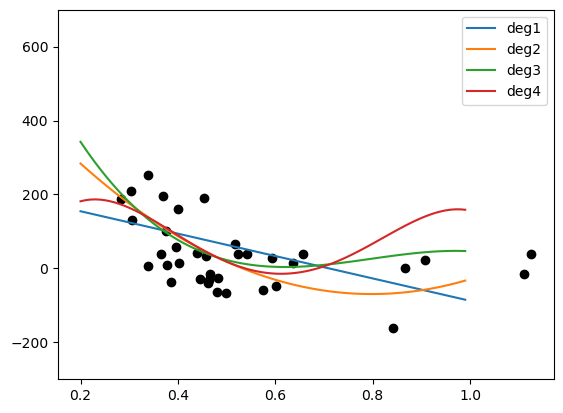

In [ ]:
daf_c = data_allF[data_allF['Group']=='C']
daf_c['Id'] = daf_c['Subject'] + '_' + daf_c['Session'].astype(str)
daf_c['sAge'] = daf_c['Age']/50
daf_c['sAge2'] = daf_c['sAge']**2
daf_c['sAge3'] = daf_c['sAge']**3
daf_c['sAge4'] = daf_c['sAge']**4
daf_c['sqrt_t'] = np.sqrt(daf_c['time_rel'])
sAge_values = np.arange(0.2,1,0.01)
sAge_values2 = sAge_values**2
sAge_values3 = sAge_values**3
sAge_values4 = sAge_values**4


for name, Subject in daf_c.groupby('Id'):
    model_id = Lm('Slope ~ time_rel', data=Subject)
    result = model_id.fit()
    coef = result['Estimate'][1]
    #age = Subject['sAge'].unique()[0]
    plt.scatter(age,coef, color='black')

#Sqrt deg 1:

model1 = Lm('Slope ~ time_rel * (sAge)', data=daf_c)
model1.fit()
plt.plot(sAge_values, model1.coefs['Estimate'][1] 
                                                + model1.coefs['Estimate'][3]*sAge_values 
                                                ,label = 'deg1')

#Sqrt deg 2:

model2 = Lm('Slope ~ time_rel * (sAge + sAge2)', data=daf_c)
model2.fit()
plt.plot(sAge_values, model2.coefs['Estimate'][1] 
                                                + model2.coefs['Estimate'][4]*sAge_values 
                                                + model2.coefs['Estimate'][5]*sAge_values2 
                                                ,label = 'deg2')

#Sqrt deg 3:

model3 = Lm('Slope ~ time_rel * (sAge + sAge2 + sAge3)', data=daf_c)
model3.fit()
plt.plot(sAge_values, model3.coefs['Estimate'][1] 
                                                + model3.coefs['Estimate'][5]*sAge_values
                                                + model3.coefs['Estimate'][6]*sAge_values2
                                                + model3.coefs['Estimate'][7]*sAge_values3
                                                ,label = 'deg3')


#Sqrt deg 4:

model4 = Lm('Slope ~ time_rel * (sAge + sAge2 + sAge3 + sAge4)', data=daf_c)
model4.fit()
plt.plot(sAge_values, model4.coefs['Estimate'][1] 
                                                + model4.coefs['Estimate'][6]*sAge_values 
                                                + model4.coefs['Estimate'][7]*sAge_values2
                                                + model4.coefs['Estimate'][8]*sAge_values3
                                                + model4.coefs['Estimate'][9]*sAge_values4
                                                ,label = 'deg4')

plt.ylim([-300,700])
plt.legend()
plt.show()


## LOG PRED PLOT

/tmp/ipykernel_2747101/38719194.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  daf_c['Id'] = daf_c['Subject'] + '_' + daf_c['Session'].astype(str)
/tmp/ipykernel_2747101/38719194.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  daf_c['sAge'] = daf_c['Age']/50


36
36
36


[]

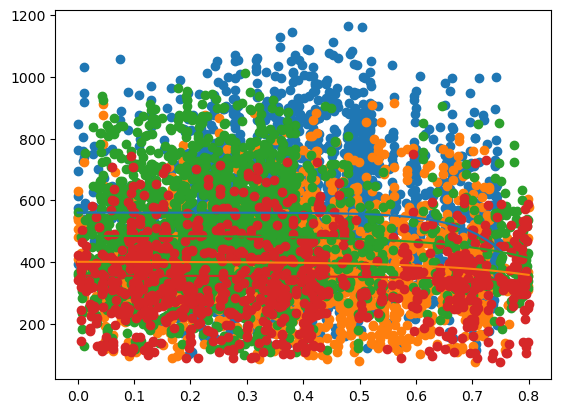

In [ ]:
daf_c = data_allF[data_allF['Group']=='C']
daf_c['Id'] = daf_c['Subject'] + '_' + daf_c['Session'].astype(str)
daf_c['sAge'] = daf_c['Age']/50




def func(x, a, b, c):
    return a  + (b * np.exp(-x/c))

c = 0
f = 0
g = 0

for name, Subject in daf_c.groupby('Id'):
    c = c +1

    #plt.scatter(Subject.time_rel.values,Subject.Slope.values)
    x = Subject.time_rel.values
    y = Subject.Slope.values

      
    popt, pcov = curve_fit(func, x, y)
    g = g + 1
    #plt.plot(x, func(x,popt[0],popt[1],popt[2]))
    coef = 1/popt[1]
    #age = Subject['sAge'].unique()[0]
    #plt.scatter(age,coef, color='black')

    f = f + 1
    #print(Subject['sAge'].unique()[0])
    #print(coef)

    if coef < -1:
        plt.scatter(Subject.time_rel.values,Subject.Slope.values)
        plt.plot(x, func(x,popt[0],popt[1],popt[2]))
    
    
print(c)
print(f)
print(g)
    
plt.plot()

# NO BINS MODEL

In [ ]:
daf_c = data_allF[data_allF['Group']=='C']
daf_c['Id'] = daf_c['Subject'] + '_' + daf_c['Session'].astype(str)
daf_c['sAge'] = daf_c['Age']/50
daf_c.head()

/tmp/ipykernel_2747101/2859326843.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  daf_c['Id'] = daf_c['Subject'] + '_' + daf_c['Session'].astype(str)
/tmp/ipykernel_2747101/2859326843.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  daf_c['sAge'] = daf_c['Age']/50


,index,Wave,Start,NegPeak,MidCrossing,PosPeak,End,Duration,ValNegPeak,ValPosPeak,PTP,Slope,Frequency,Stage,Channel,IdxChannel,Group,Subject,Session,Age,Machine,ConfArousal,Position,N3_times,time_rel,Id,sAge
47,2831880,12769,0.673000,2423.08,2423.34,2423.57,2423.91,1.11,-46.707747,32.177395,78.885141,303.404390,0.900901,3,F3,7,C,C02,1,22.91,O,0,F,0.673,0.000000,C02_1,0.4582
48,2830582,11471,0.679381,2446.06,2446.33,2446.52,2447.30,1.53,-89.754462,38.805616,128.560078,476.148436,0.653595,3,F7,6,C,C02,1,22.91,O,0,F,0.673,0.006381,C02_1,0.4582
49,2833475,14364,0.679381,2446.04,2446.28,2446.48,2446.75,0.98,-117.820316,70.414380,188.234695,784.311231,1.020408,3,Fz,8,C,C02,1,22.91,O,0,F,0.673,0.006381,C02_1,0.4582
50,2835266,16155,0.679381,2446.03,2446.27,2446.47,2446.75,0.98,-111.116778,73.118567,184.235346,767.647273,1.020408,3,F4,9,C,C02,1,22.91,O,0,F,0.673,0.006381,C02_1,0.4582
51,2836802,17691,0.679381,2446.02,2446.25,2446.47,2446.79,1.02,-55.017271,42.728858,97.746129,424.983169,0.980392,3,F8,10,C,C02,1,22.91,O,0,F,0.673,0.006381,C02_1,0.4582


(array([7629., 2848., 7436., 3114., 9113., 7836.,    0., 3870., 9012.,
        2762.,  492., 3834., 3674.,  902.,  466., 2500., 1130., 1701.,
           0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,   88.,
         419.,    0.,  256.,    0.,    0.,    0.,    0.,    0.,    0.,
           0.,    0.,    0., 1803.]),
 array([0.284  , 0.30505, 0.3261 , 0.34715, 0.3682 , 0.38925, 0.4103 ,
        0.43135, 0.4524 , 0.47345, 0.4945 , 0.51555, 0.5366 , 0.55765,
        0.5787 , 0.59975, 0.6208 , 0.64185, 0.6629 , 0.68395, 0.705  ,
        0.72605, 0.7471 , 0.76815, 0.7892 , 0.81025, 0.8313 , 0.85235,
        0.8734 , 0.89445, 0.9155 , 0.93655, 0.9576 , 0.97865, 0.9997 ,
        1.02075, 1.0418 , 1.06285, 1.0839 , 1.10495, 1.126  ]),
 <BarContainer object of 40 artists>)

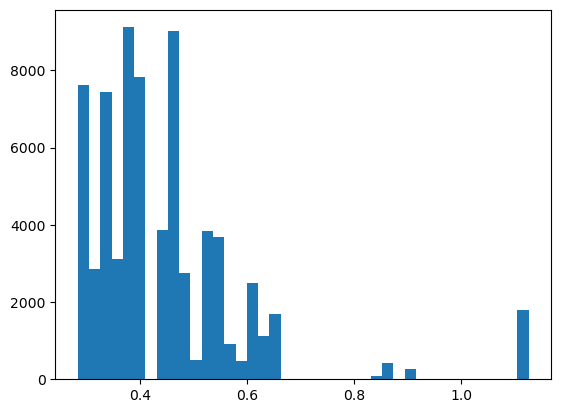

In [ ]:
plt.hist(daf_c['sAge'],40)

# UP TO deg 5

In [ ]:


model_sq = Lmer('Slope ~ time_rel * (sAge + I(sAge^2) + I(sAge^3) + I(sAge^4) + I(sAge^5)) + (1|Subject:Session)', data=daf_c)



# Fit and print an R/statsmodels style summary 
# with t/z-tests, CIs, and p-values
model_sq.fit()
print(model_sq.coefs)


# Access model attributes
print('BIC: ' + str(model_sq.BIC))
model_sq.residuals


/home/amoran/miniconda3/envs/yasa_env/lib/python3.11/site-packages/rpy2/robjects/pandas2ri.py:65: UserWarning: Error while trying to convert the column "ConfArousal". Fall back to string conversion. The error is: Converting pandas "Category" series to R factor is only possible when categories are strings.
  warnings.warn('Error while trying to convert '


Linear mixed model fit by REML [’lmerMod’]
Formula: Slope~time_rel*(sAge+I(sAge^2)+I(sAge^3)+I(sAge^4)+I(sAge^5))+(1|Subject:Session)

Family: gaussian	 Inference: parametric

Number of observations: 70885	 Groups: {'Subject:Session': 36.0}

Log-likelihood: -468538.719 	 AIC: 937105.439

Random effects:

                        Name        Var      Std
Subject:Session  (Intercept)   2783.254   52.757
Residual                      32268.013  179.633

No random effect correlations specified

Fixed effects:

                        Estimate         2.5_ci        97.5_ci             SE  \
(Intercept)           545.230148   -4205.704435    5296.164730    2423.990757   
time_rel              650.151609   -1359.763086    2660.066304    1025.485525   
sAge                 2439.862933  -40785.782097   45665.507963   22054.305779   
I(sAge^2)          -18231.543279 -168347.025651  131883.939093   76590.939199   
I(sAge^3)           44263.778946 -204135.601478  292663.159371  126736.706585   
I(s

/home/amoran/miniconda3/envs/yasa_env/lib/python3.11/site-packages/pymer4/models/Lmer.py:733: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  ran_vars = ran_vars.applymap(


array([-182.42663567,   -9.98758106,  298.17521341, ...,   79.22585185,
         53.6560655 ,  190.42256289])

/home/amoran/miniconda3/envs/yasa_env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/amoran/miniconda3/envs/yasa_env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/amoran/miniconda3/envs/yasa_env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/amoran/miniconda3/envs/yasa_env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be remov

<Axes: xlabel='Estimate'>

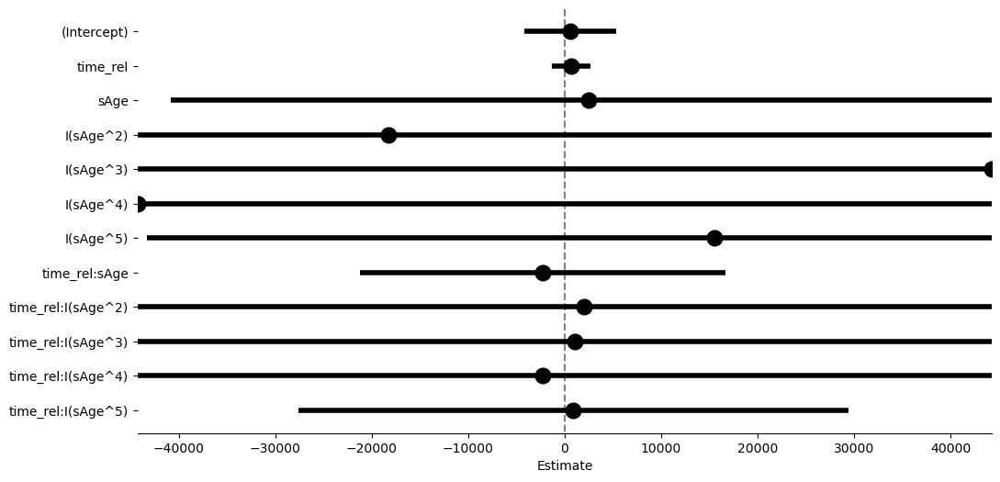

In [ ]:
model_sq.plot_summary()

In [ ]:
plt.figure(figsize=(10, 6))

sAge_values = np.arange(0.2,0.8,0.1)
unique_time_rel_values = daf_c['time_rel'].unique()
123922

for age in sAge_values:
    times = np.linspace(min(daf_c['time_rel'].unique()), max(daf_c['time_rel'].unique()),100)

    times_out = []
    while len(times_out) < 15362:
        times_out.extend(times)


    times_out = times_out[:15362]

    df_pred = pd.DataFrame({'time_rel': times_out})
    df_pred['sAge'] = age
    df_pred['Slope'] = model_sq.predict(df_pred, skip_data_checks=True)
    plt.plot(df_pred['time_rel'][0:100],df_pred['Slope'][0:100], label = round(age*50,2))


plt.xlabel('Time')
plt.ylabel('Predicted Slopes')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()    


/home/amoran/miniconda3/envs/yasa_env/lib/python3.11/site-packages/rpy2/robjects/pandas2ri.py:65: UserWarning: Error while trying to convert the column "ConfArousal". Fall back to string conversion. The error is: Converting pandas "Category" series to R factor is only possible when categories are strings.
  warnings.warn('Error while trying to convert '


ValueError: Length of values (70885) does not match length of index (15362)

<Figure size 1000x600 with 0 Axes>

# Up to 2 deg BOTH

In [ ]:
model_sq = Lmer('Slope ~ time_rel * (sAge + I(sAge^2)) + I(sqrt(time_rel)) * (sAge + I(sAge^2)) + (1|Subject:Session)', data=daf_c)



# Fit and print an R/statsmodels style summary 
# with t/z-tests, CIs, and p-values
model_sq.fit()
print(model_sq.coefs)


# Access model attributes
print('BIC: ' + str(model_sq.BIC))
model_sq.residuals


Linear mixed model fit by REML [’lmerMod’]
Formula: Slope~time_rel*(sAge+I(sAge^2))+I(sqrt(time_rel))*(sAge+I(sAge^2))+(1|Subject:Session)

Family: gaussian	 Inference: parametric

Number of observations: 15362	 Groups: {'Subject:Session': 32.0}

Log-likelihood: -102381.231 	 AIC: 204784.462

Random effects:

                        Name        Var      Std
Subject:Session  (Intercept)   3953.781   62.879
Residual                      36005.746  189.752

No random effect correlations specified

Fixed effects:

                                Estimate       2.5_ci      97.5_ci  \
(Intercept)                   305.326359  -195.244724   805.897442   
time_rel                      -28.407445 -1186.611038  1129.796147   
sAge                           82.758625 -1890.453768  2055.971018   
I(sAge^2)                     148.229150 -1690.067729  1986.526028   
I(sqrt(time_rel))             813.992976  -606.018835  2234.004788   
time_rel:sAge                -603.437313 -5307.231487  4100.3568

/home/amoran/miniconda3/envs/yasa_env/lib/python3.11/site-packages/pymer4/models/Lmer.py:733: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  ran_vars = ran_vars.applymap(


array([-247.15359379,  -48.63753464,   16.24605027, ...,  338.3323455 ,
        -76.30385387, -163.44301389])

/home/amoran/miniconda3/envs/yasa_env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/amoran/miniconda3/envs/yasa_env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/amoran/miniconda3/envs/yasa_env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/amoran/miniconda3/envs/yasa_env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be remov

<Axes: xlabel='Estimate'>

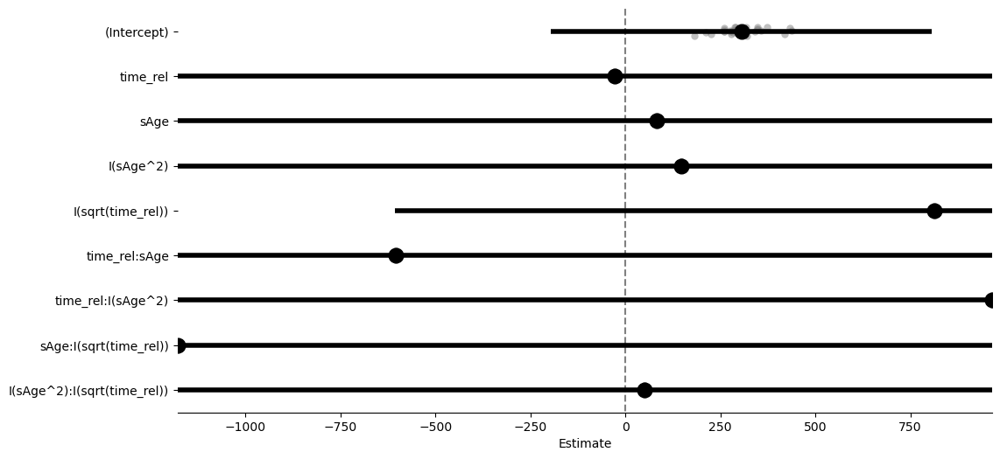

In [ ]:
model_sq.plot_summary()

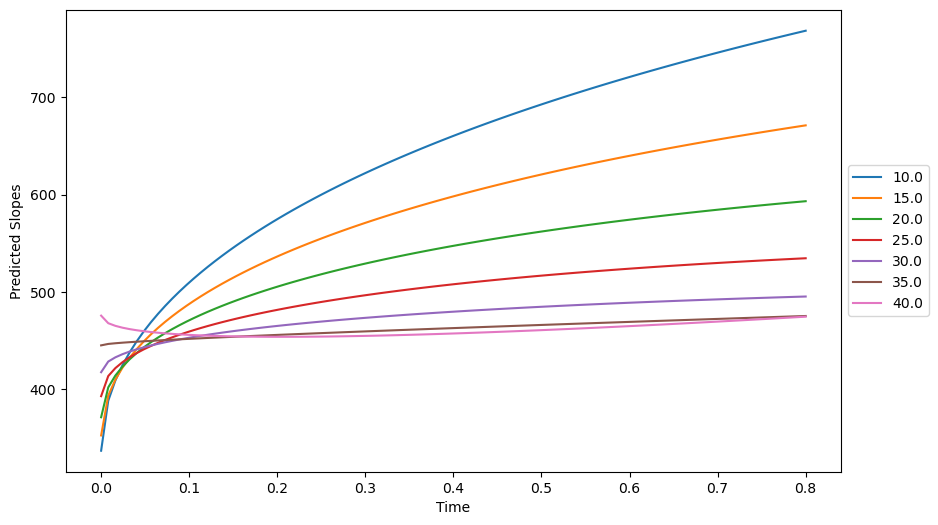

In [ ]:
plt.figure(figsize=(10, 6))

sAge_values = np.arange(0.2,0.8,0.1)
unique_time_rel_values = daf_c['time_rel'].unique()
123922

for age in sAge_values:
    times = np.linspace(min(daf_c['time_rel'].unique()), max(daf_c['time_rel'].unique()),100)
    
    times_out = []
    while len(times_out) < 15362:
        times_out.extend(times)


    times_out = times_out[:15362]

    df_pred = pd.DataFrame({'time_rel': times_out})
    df_pred['sAge'] = age
    df_pred['Slope'] = model_sq.predict(df_pred, skip_data_checks=True)
    plt.plot(df_pred['time_rel'][0:100],df_pred['Slope'][0:100], label = round(age*50,2))


plt.xlabel('Time')
plt.ylabel('Predicted Slopes')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()    


# SQRT 5 Deg BOTH

In [ ]:


model_sq = Lmer('Slope ~ I(sqrt(time_rel)) * (sAge + I(sAge^2) +  I(sAge^3)) + time_rel * (sAge + I(sAge^2) + I(sAge^3)) + (1|Subject:Session)', data=daf_c)



# Fit and print an R/statsmodels style summary 
# with t/z-tests, CIs, and p-values
model_sq.fit()
print(model_sq.coefs)


# Access model attributes
print('BIC: ' + str(model_sq.BIC))
model_sq.residuals


Linear mixed model fit by REML [’lmerMod’]
Formula: Slope~I(sqrt(time_rel))*(sAge+I(sAge^2)+I(sAge^3))+time_rel*(sAge+I(sAge^2)+I(sAge^3))+(1|Subject:Session)

Family: gaussian	 Inference: parametric

Number of observations: 15362	 Groups: {'Subject:Session': 32.0}

Log-likelihood: -102349.974 	 AIC: 204727.949

Random effects:

                        Name        Var      Std
Subject:Session  (Intercept)   3606.192   60.052
Residual                      36006.367  189.753

No random effect correlations specified

Fixed effects:

                                 Estimate        2.5_ci        97.5_ci  \
(Intercept)                     36.922543  -1799.604734    1873.449820   
I(sqrt(time_rel))             4522.657768   -701.952485    9747.268022   
sAge                          1904.851570  -9224.171641   13033.874781   
I(sAge^2)                    -3669.305727 -24993.713699   17655.102246   
I(sAge^3)                     2442.506488 -10357.671495   15242.684472   
time_rel            

/home/amoran/miniconda3/envs/yasa_env/lib/python3.11/site-packages/pymer4/models/Lmer.py:733: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  ran_vars = ran_vars.applymap(


array([-258.63390099,  -57.65674197,   10.43682056, ...,  336.66618106,
        -77.97283668, -165.11606538])

/home/amoran/miniconda3/envs/yasa_env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/amoran/miniconda3/envs/yasa_env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/amoran/miniconda3/envs/yasa_env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/amoran/miniconda3/envs/yasa_env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be remov

<Axes: xlabel='Estimate'>

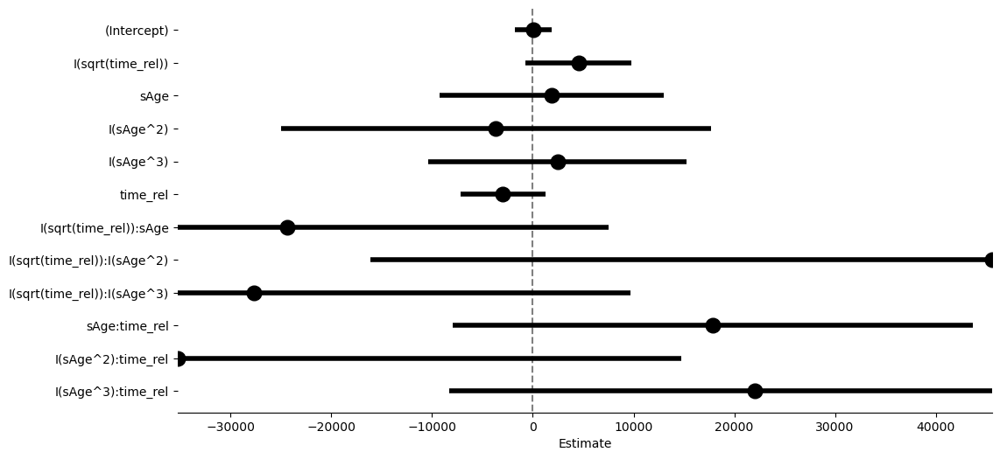

In [ ]:
model_sq.plot_summary()

In [ ]:
plt.figure(figsize=(10, 6))

sAge_values = np.arange(0.2,0.8,0.1)
unique_time_rel_values = daf_c['time_rel'].unique()
123922

for age in sAge_values:
    times = np.linspace(min(daf_c['time_rel'].unique()), max(daf_c['time_rel'].unique()),100)
    
    times_out = []
    while len(times_out) < 123921:
        times_out.extend(times)


    times_out = times_out[:123921]

    df_pred = pd.DataFrame({'time_rel': times_out})
    df_pred['sAge'] = age
    df_pred['Slope'] = model_sq.predict(df_pred, skip_data_checks=True)
    plt.plot(df_pred['time_rel'][0:100],df_pred['Slope'][0:100], label = round(age*50,2))


plt.xlabel('Time')
plt.ylabel('Predicted Slopes')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()    

ValueError: operands could not be broadcast together with shapes (15362,) (123921,) 

<Figure size 1000x600 with 0 Axes>

# SQRT deg 2

In [ ]:
model_sq = Lmer('Slope ~ I(sqrt(time_rel)) * (sAge + I(sAge^2)) + (1|Subject:Session)', data=daf_c)



# Fit and print an R/statsmodels style summary 
# with t/z-tests, CIs, and p-values
model_sq.fit()
print(model_sq.coefs)


# Access model attributes
print('BIC: ' + str(model_sq.BIC))
model_sq.residuals

Linear mixed model fit by REML [’lmerMod’]
Formula: Slope~I(sqrt(time_rel))*(sAge+I(sAge^2))+(1|Subject:Session)

Family: gaussian	 Inference: parametric

Number of observations: 123921	 Groups: {'Subject:Session': 32.0}

Log-likelihood: -818610.531 	 AIC: 1637237.061

Random effects:

                        Name        Var      Std
Subject:Session  (Intercept)   4269.829   65.344
Residual                      31984.732  178.843

No random effect correlations specified

Fixed effects:

                                Estimate       2.5_ci      97.5_ci  \
(Intercept)                   332.977855    58.379422   607.576289   
I(sqrt(time_rel))             644.881553   550.828292   738.934814   
sAge                           69.927264  -975.555671  1115.410200   
I(sAge^2)                     -11.091886  -945.498875   923.315104   
I(sqrt(time_rel)):sAge      -1453.831688 -1854.669336 -1052.994040   
I(sqrt(time_rel)):I(sAge^2)   913.942258   505.618396  1322.266121   

                 

/home/amoran/miniconda3/envs/yasa_env/lib/python3.11/site-packages/pymer4/models/Lmer.py:733: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  ran_vars = ran_vars.applymap(


array([  96.03910818,  119.93726911, -146.7354911 , ..., -129.03346606,
       -166.11564097, -278.91066559])

/home/amoran/miniconda3/envs/yasa_env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/amoran/miniconda3/envs/yasa_env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/amoran/miniconda3/envs/yasa_env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/amoran/miniconda3/envs/yasa_env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be remov

<Axes: xlabel='Estimate'>

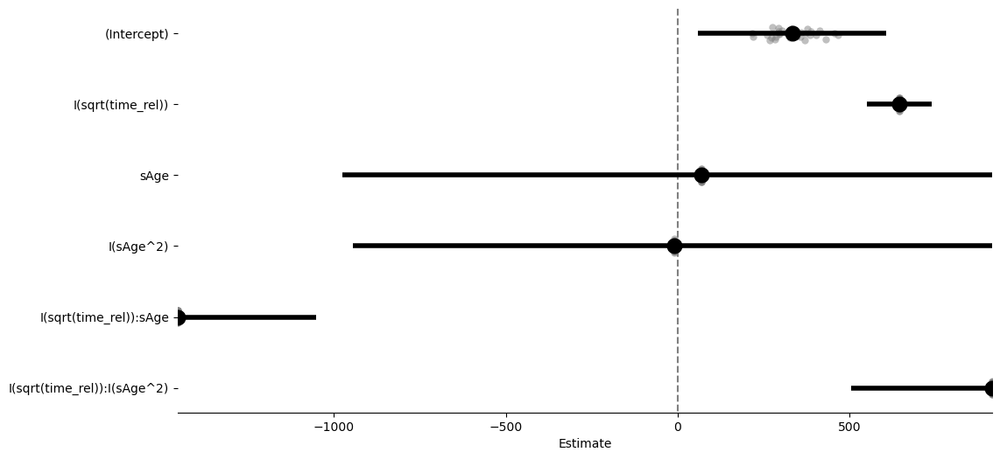

In [ ]:
model_sq.plot_summary()

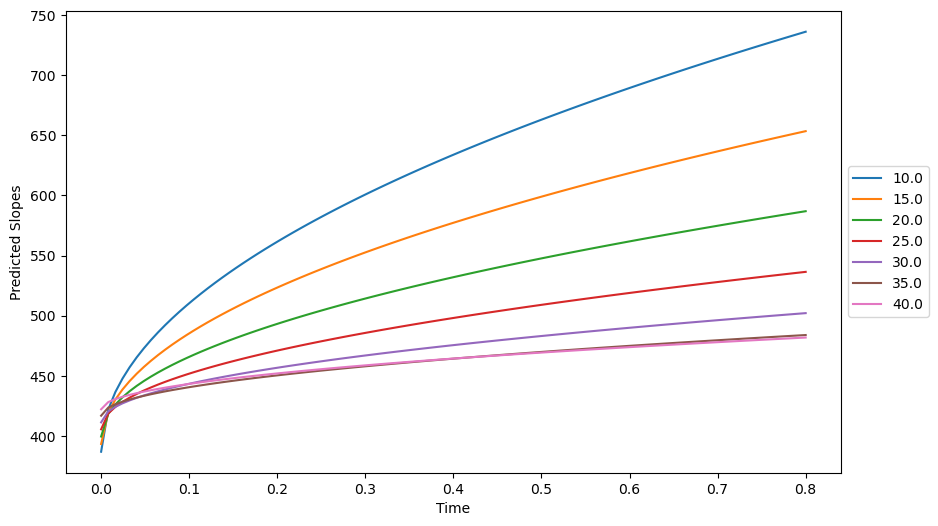

In [ ]:
plt.figure(figsize=(10, 6))

sAge_values = np.arange(0.2,0.8,0.1)
unique_time_rel_values = daf_c['time_rel'].unique()
123922

for age in sAge_values:
    times = np.linspace(min(daf_c['time_rel'].unique()), max(daf_c['time_rel'].unique()),100)
    
    times_out = []
    while len(times_out) < 123921:
        times_out.extend(times)


    times_out = times_out[:123921]

    df_pred = pd.DataFrame({'time_rel': times_out})
    df_pred['sAge'] = age
    df_pred['Slope'] = model_sq.predict(df_pred, skip_data_checks=True)
    plt.plot(df_pred['time_rel'][0:100],df_pred['Slope'][0:100], label = round(age*50,2))


plt.xlabel('Time')
plt.ylabel('Predicted Slopes')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()   